<a href="https://colab.research.google.com/github/ram130849/object_detection_using_faster_rcnn/blob/main/Final_ExDark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Computer Vision Project ExDark Dataset Notebook


In [1]:
# Reference Notebook that I modified/adapted : https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5
# The above note book is a tutorial to use detectron2 APIs run inference with an existing model and train a builtin model on a custom dataset
# We also referred to this notebook that has used our dataset and the detectron2 tutorial: https://github.com/Yashsshah909/Object-detection-of-low-light-images-using-the-Exclusively-Dark-ExDark-dataset./blob/main/Fast_RCNN_and_Faster_RCNN.ipynb


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import pandas as pd
import numpy as np
import re
# from tqdm.notebook import tqdm
import tqdm
import xml.etree.ElementTree as ET
from pathlib import Path
import cv2
import os
import shutil
from sklearn import model_selection, preprocessing
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
!unzip '/content/drive/MyDrive/ExDark/ExDark.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/ExDark/Motorbike/2017_07361.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2017_07361.jpg  
  inflating: /content/ExDark/Motorbike/2015_06160.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_06160.jpg  
  inflating: /content/ExDark/Motorbike/2015_05864.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05864.jpg  
  inflating: /content/ExDark/Motorbike/2015_05870.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05870.jpg  
  inflating: /content/ExDark/Motorbike/2015_05858.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05858.jpg  
  inflating: /content/ExDark/Motorbike/2015_05874.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05874.jpg  
  inflating: /content/ExDark/Motorbike/2015_05860.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05860.jpg  
  inflating: /content/ExDark/Motorbike/2015_05848.jpg  
  inflating: /content/__MACOSX/E

In [5]:
!unzip '/content/drive/MyDrive/ExDark/ExDark_Annno.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/ExDark_Annno/Motorbike/2015_05787.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05787.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05797.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05797.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05933.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05933.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05923.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05923.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05951.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05951.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05829.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05829.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05941.jpg.txt  
  inflating: /content/__M

In [62]:
# Class and Property Dictionarties for Dataset 
class_size=13
reverse_class_dict = {'bicycle': 1, 'boat': 2, 'bottle': 3, 'bus': 4, 'car': 5, 'cat': 6, 'chair': 7, 'cup': 8, 'dog': 9, 'motorbike': 10, 'people': 11, 'table': 12}
class_dict = {1:'Bicycle',2:'Boat',3:'Bottle',4:'Bus',5:'Car',6:'Cat',7:'Chair',8:'Cup',9:'Dog',10:'Motorbike',11:'People',12:'Table'}
total_dict = {0:'BackGround',1:'Bicycle',2:'Boat',3:'Bottle',4:'Bus',5:'Car',6:'Cat',7:'Chair',8:'Cup',9:'Dog',10:'Motorbike',11:'People',12:'Table'}
light_dict = {1:'Low',2:'Ambient',3:'Object',4:'Single',5:'Weak',6:'Strong',7:'Screen',8:'Window',9:'Shadow',10:'Twilight'}
in_out_dict = {1:'Indoor',2:'Outdoor'}
train_val_test = {1:'train',2:'val',3:'test'}

In [7]:
classes = [val.lower() for val in list(class_dict.values())]

In [8]:
print( list(class_dict.keys()) [list(class_dict.values()).index('Bicycle')] )

1


In [9]:
!cp '/content/drive/MyDrive/ExDark/imageclasslist.txt' -d '/content/'

In [10]:
# Build Dataframe
df = pd.read_csv('/content/imageclasslist.txt',sep=' ',header=None,skiprows=1)
df.columns = ['Name','Class','Light','In/Out','Train/Val/Test']

In [11]:
# Build Dataframe
df.loc[df.Class==1,'Name'] = '/content/ExDark/' + class_dict[1] + '/' +  df['Name']
df.loc[df.Class==2,'Name'] = '/content/ExDark/' + class_dict[2] + '/' +  df['Name']
df.loc[df.Class==3,'Name'] = '/content/ExDark/' + class_dict[3] + '/' +  df['Name']
df.loc[df.Class==4,'Name'] = '/content/ExDark/' + class_dict[4] + '/' +  df['Name']
df.loc[df.Class==5,'Name'] = '/content/ExDark/' + class_dict[5] + '/' +  df['Name']
df.loc[df.Class==6,'Name'] = '/content/ExDark/' + class_dict[6] + '/' +  df['Name']
df.loc[df.Class==7,'Name'] = '/content/ExDark/' + class_dict[7] + '/' +  df['Name']
df.loc[df.Class==8,'Name'] = '/content/ExDark/' + class_dict[8] + '/' +  df['Name']
df.loc[df.Class==9,'Name'] = '/content/ExDark/' + class_dict[9] + '/' +  df['Name']
df.loc[df.Class==10,'Name'] = '/content/ExDark/' + class_dict[10] + '/' + df['Name']
df.loc[df.Class==11,'Name'] = '/content/ExDark/' + class_dict[11] + '/' +df['Name']
df.loc[df.Class==12,'Name'] = '/content/ExDark/' + class_dict[12] + '/' +df['Name']

In [12]:
print(df.head(10))

                                     Name  Class  Light  In/Out  \
0  /content/ExDark/Bicycle/2015_00001.png      1      2       1   
1  /content/ExDark/Bicycle/2015_00002.png      1      6       2   
2  /content/ExDark/Bicycle/2015_00003.png      1      5       2   
3  /content/ExDark/Bicycle/2015_00004.jpg      1      3       2   
4  /content/ExDark/Bicycle/2015_00005.jpg      1      6       2   
5  /content/ExDark/Bicycle/2015_00006.jpg      1      6       2   
6  /content/ExDark/Bicycle/2015_00007.jpg      1      2       2   
7  /content/ExDark/Bicycle/2015_00008.jpg      1      6       2   
8  /content/ExDark/Bicycle/2015_00009.jpg      1      6       2   
9  /content/ExDark/Bicycle/2015_00010.jpg      1      5       2   

   Train/Val/Test  
0               1  
1               1  
2               1  
3               1  
4               1  
5               1  
6               1  
7               1  
8               1  
9               1  


In [13]:
print(len(df))

7363


In [14]:
# Analyze count/split of Dataset
train_val_test_count = df['Train/Val/Test'].value_counts().rename_axis('train_val_test')
train_count = train_val_test_count[1] 
val_count = train_val_test_count[2]
test_count = train_val_test_count[3]
print('train,val,test:',train_count,val_count,test_count)
train_count = train_count + val_count
test_count = test_count

print("total count: {}".format(train_count+test_count))

train,val,test: 3000 1800 2563
total count: 7363


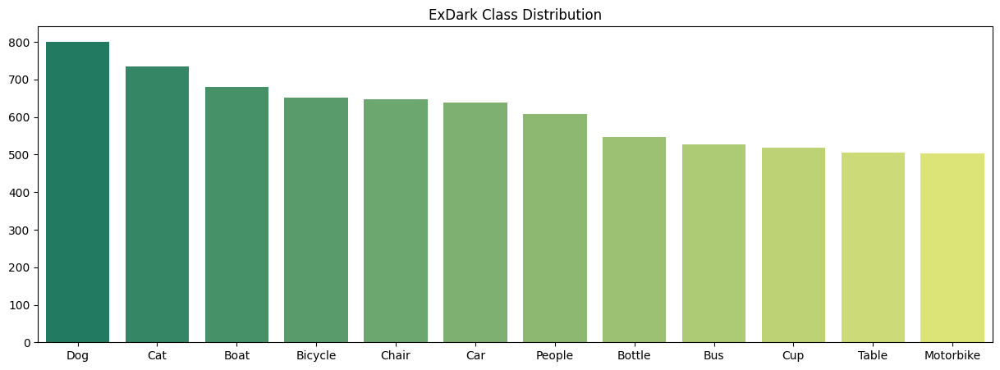

In [15]:
# Visulaize Class Dist
class_labels = dict(df['Class'].value_counts())

labels = []

count = []

for i,j in class_labels.items():

    labels.append(class_dict[i])

    count.append(j)

plt.figure(figsize=(15,5))
sns.barplot(x=labels,y=count,palette='summer')
plt.title('ExDark Class Distribution')
plt.show()

In/Out Distribution: ['Outdoor', 'Indoor'] [4541, 2822]
Lightning Condt Distribution: ['Ambient', 'Strong', 'Single', 'Weak', 'Object', 'Twilight', 'Window', 'Low', 'Screen', 'Shadow'] [2098, 2059, 762, 705, 498, 416, 363, 241, 165, 56]


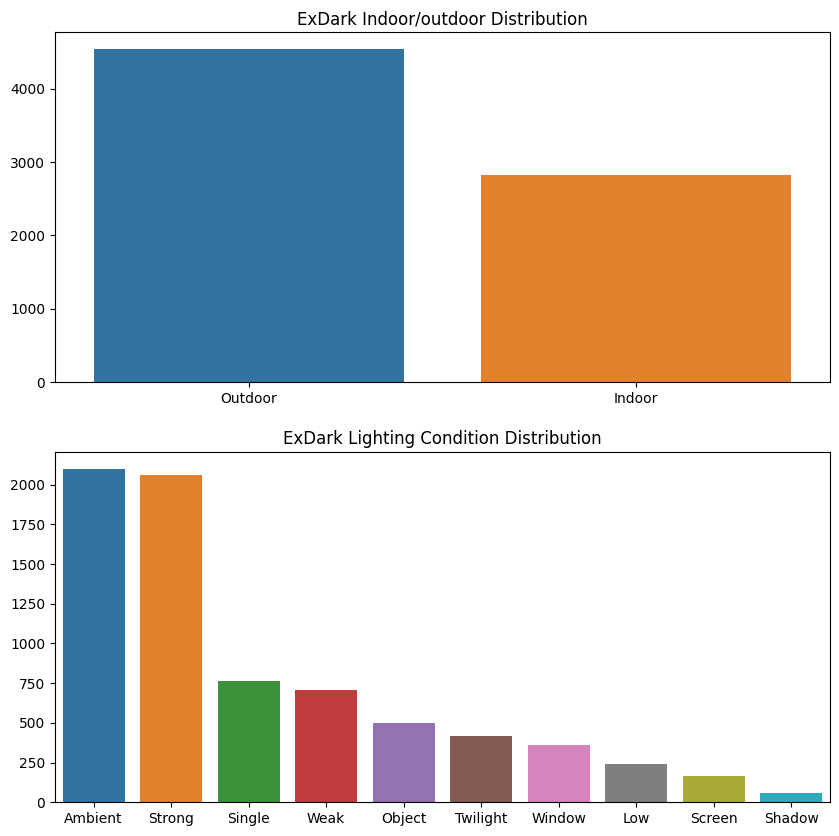

In [16]:
# function to get indoor/outdoor / lighting dist for each class
# global df
#df1 = df[df['Class']==label]

df1 = df

in_out = dict(df1['In/Out'].value_counts())
light_cond = dict(df1['Light'].value_counts())

in_out_label =[]
in_out_cnt =[]
for i,j in in_out.items():
    in_out_label.append(in_out_dict[i])
    in_out_cnt.append(j)

light_label = []
light_cnt = []
for i,j in light_cond.items():
    light_label.append(light_dict[i])
    light_cnt.append(j)

print('In/Out Distribution:',in_out_label,in_out_cnt)
print('Lightning Condt Distribution:',light_label,light_cnt)

fig,axis = plt.subplots(2,1,figsize=(10,10))
axis1 = sns.barplot(x=in_out_label,y=in_out_cnt,ax=axis[0])
axis1.set_title('ExDark Indoor/outdoor Distribution')
axis2 = sns.barplot(x=light_label,y=light_cnt,ax=axis[1])
axis2.set_title('ExDark Lighting Condition Distribution')
plt.show()

Bicycle In/Out Distribution: ['Outdoor', 'Indoor'] [627, 25]
Bicycle Lightning Condt Distribution: ['Strong', 'Ambient', 'Object', 'Weak', 'Single', 'Twilight', 'Shadow', 'Window', 'Low'] [326, 109, 64, 56, 50, 28, 8, 6, 5]


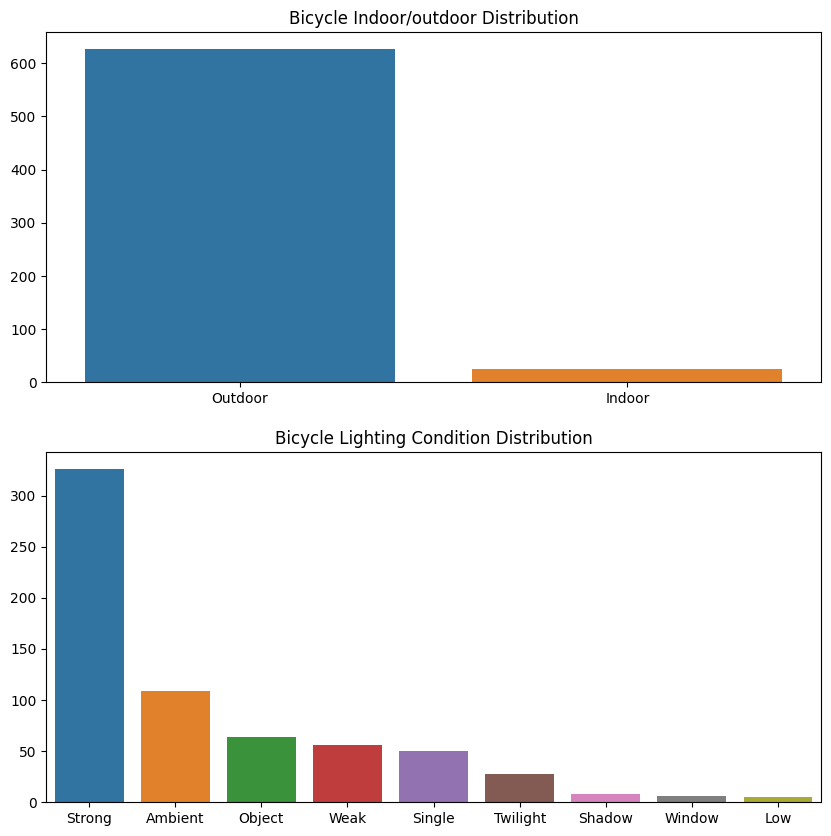

Boat In/Out Distribution: ['Outdoor', 'Indoor'] [676, 3]
Boat Lightning Condt Distribution: ['Strong', 'Twilight', 'Ambient', 'Weak', 'Single', 'Object', 'Shadow', 'Low'] [277, 254, 73, 38, 24, 5, 5, 3]


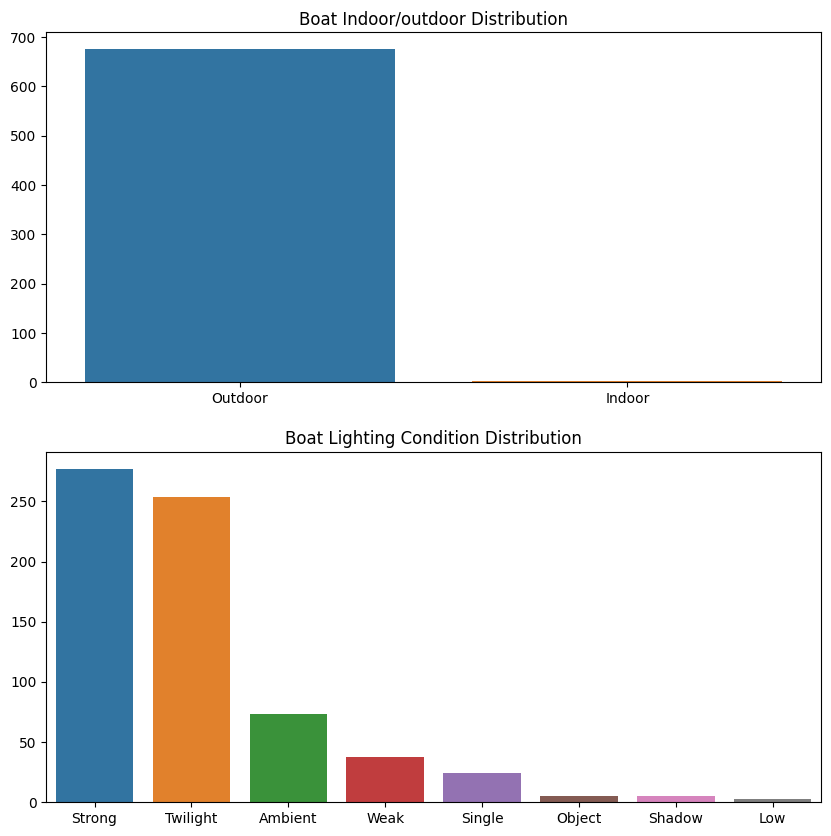

Bottle In/Out Distribution: ['Indoor', 'Outdoor'] [438, 109]
Bottle Lightning Condt Distribution: ['Ambient', 'Single', 'Weak', 'Object', 'Strong', 'Low', 'Screen', 'Window', 'Twilight', 'Shadow'] [172, 100, 65, 61, 59, 39, 30, 13, 6, 2]


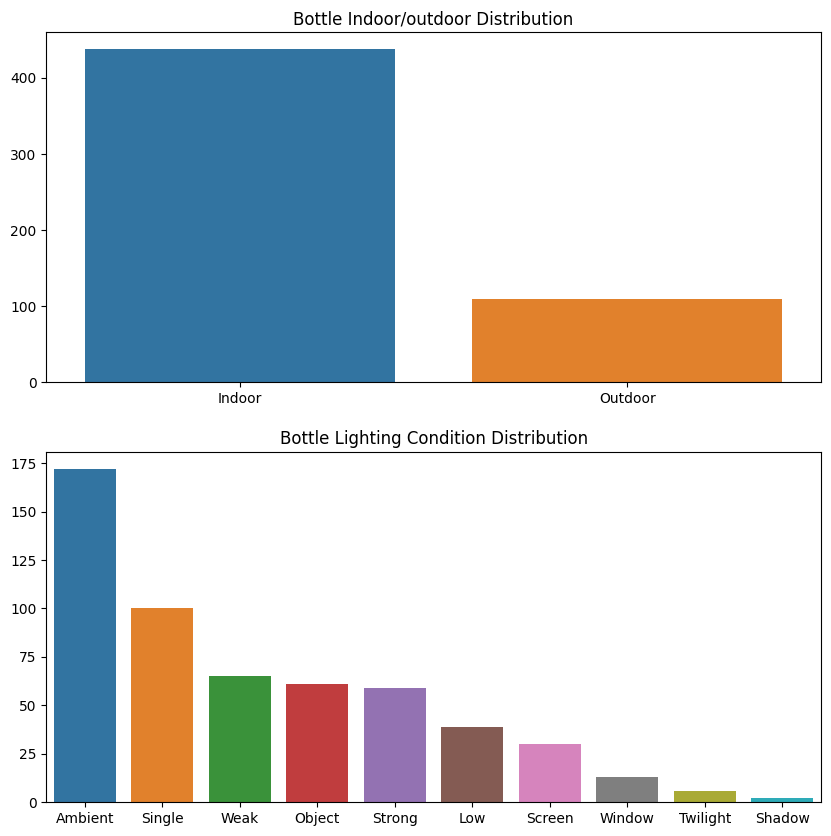

Bus In/Out Distribution: ['Outdoor', 'Indoor'] [522, 5]
Bus Lightning Condt Distribution: ['Strong', 'Weak', 'Ambient', 'Twilight', 'Object', 'Single', 'Shadow', 'Screen'] [314, 107, 42, 25, 19, 17, 2, 1]


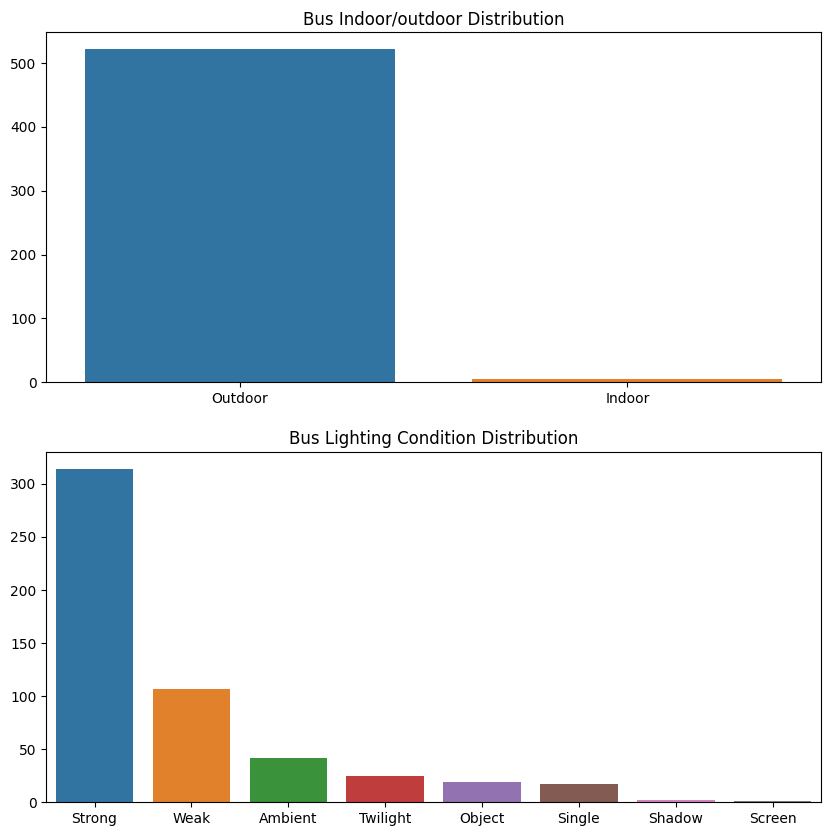

Car In/Out Distribution: ['Outdoor', 'Indoor'] [619, 19]
Car Lightning Condt Distribution: ['Strong', 'Ambient', 'Weak', 'Single', 'Twilight', 'Object', 'Low', 'Shadow'] [302, 121, 78, 59, 35, 24, 11, 8]


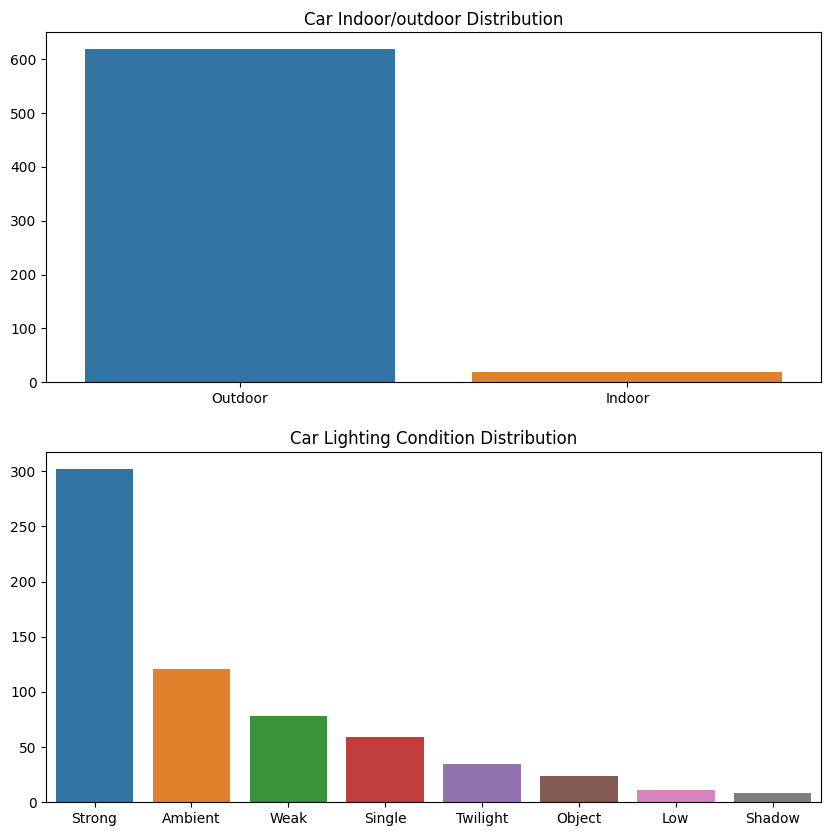

Cat In/Out Distribution: ['Indoor', 'Outdoor'] [422, 313]
Cat Lightning Condt Distribution: ['Ambient', 'Low', 'Single', 'Strong', 'Object', 'Window', 'Weak', 'Screen', 'Twilight', 'Shadow'] [404, 78, 60, 60, 51, 35, 20, 15, 8, 4]


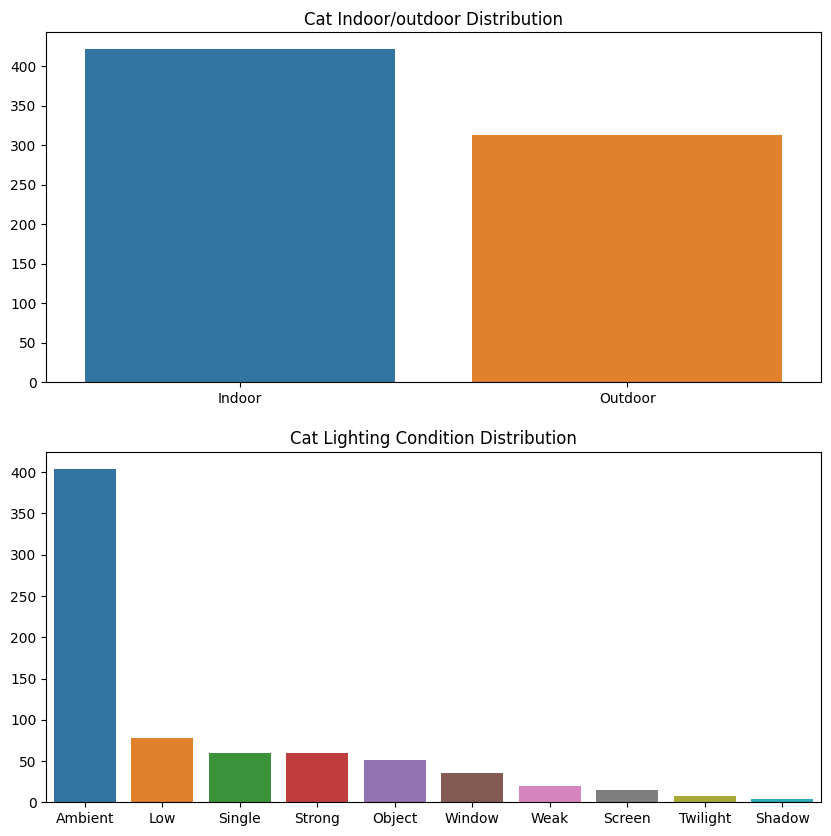

Chair In/Out Distribution: ['Indoor', 'Outdoor'] [496, 152]
Chair Lightning Condt Distribution: ['Ambient', 'Window', 'Single', 'Strong', 'Object', 'Screen', 'Weak', 'Low', 'Twilight', 'Shadow'] [188, 121, 90, 83, 48, 45, 43, 21, 6, 3]


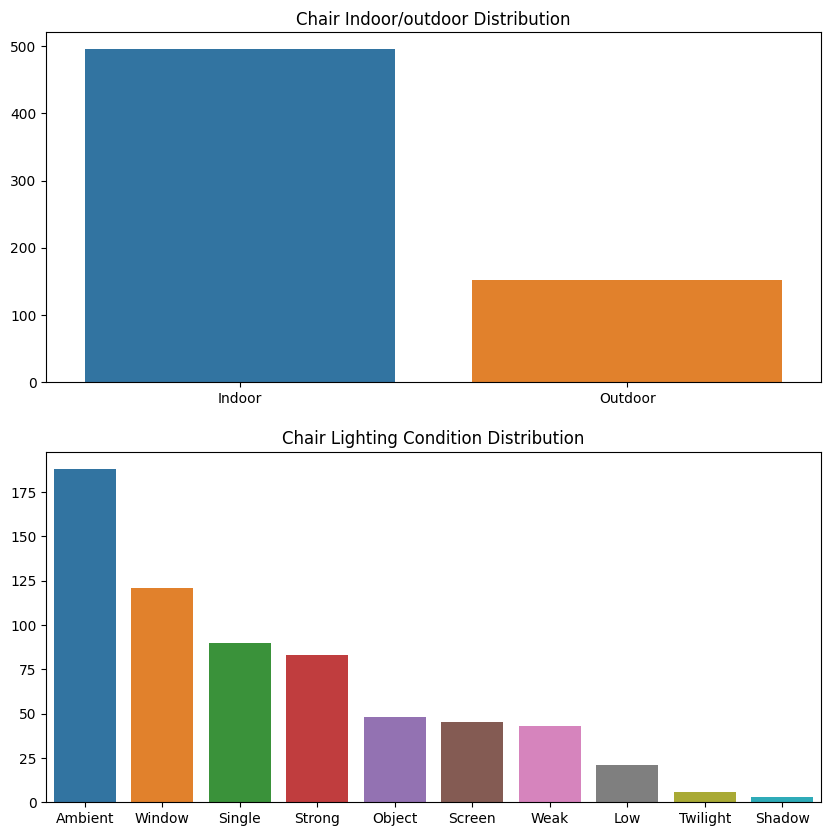

Cup In/Out Distribution: ['Indoor', 'Outdoor'] [486, 33]
Cup Lightning Condt Distribution: ['Ambient', 'Single', 'Weak', 'Screen', 'Object', 'Window', 'Strong', 'Low', 'Twilight', 'Shadow'] [228, 90, 47, 38, 37, 31, 30, 16, 1, 1]


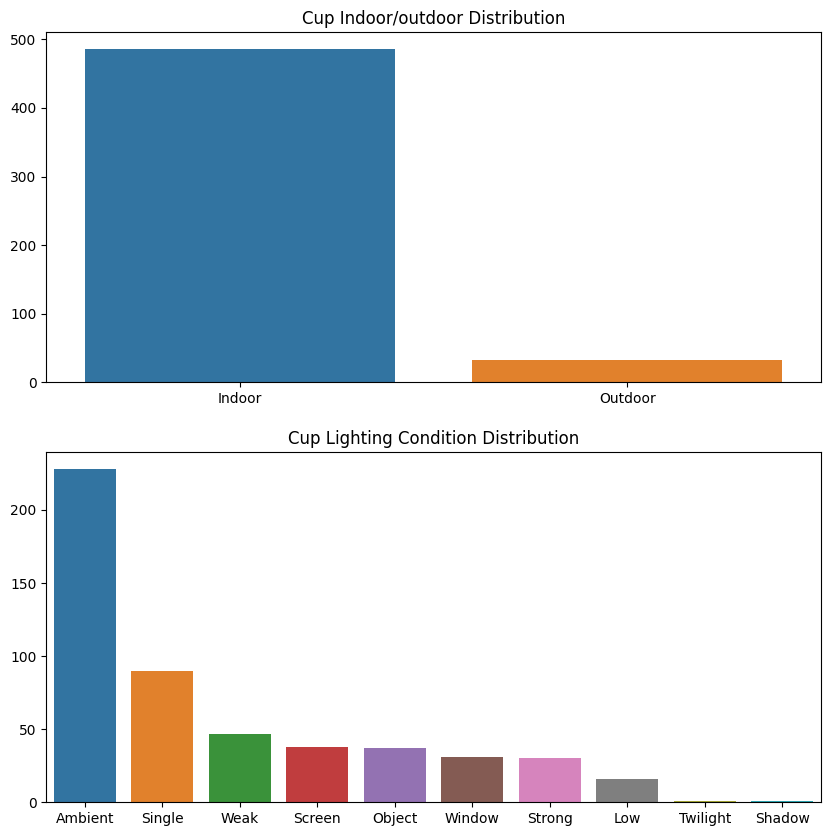

Dog In/Out Distribution: ['Outdoor', 'Indoor'] [505, 296]
Dog Lightning Condt Distribution: ['Ambient', 'Strong', 'Single', 'Object', 'Low', 'Weak', 'Window', 'Twilight', 'Shadow', 'Screen'] [419, 96, 75, 60, 42, 36, 34, 26, 7, 6]


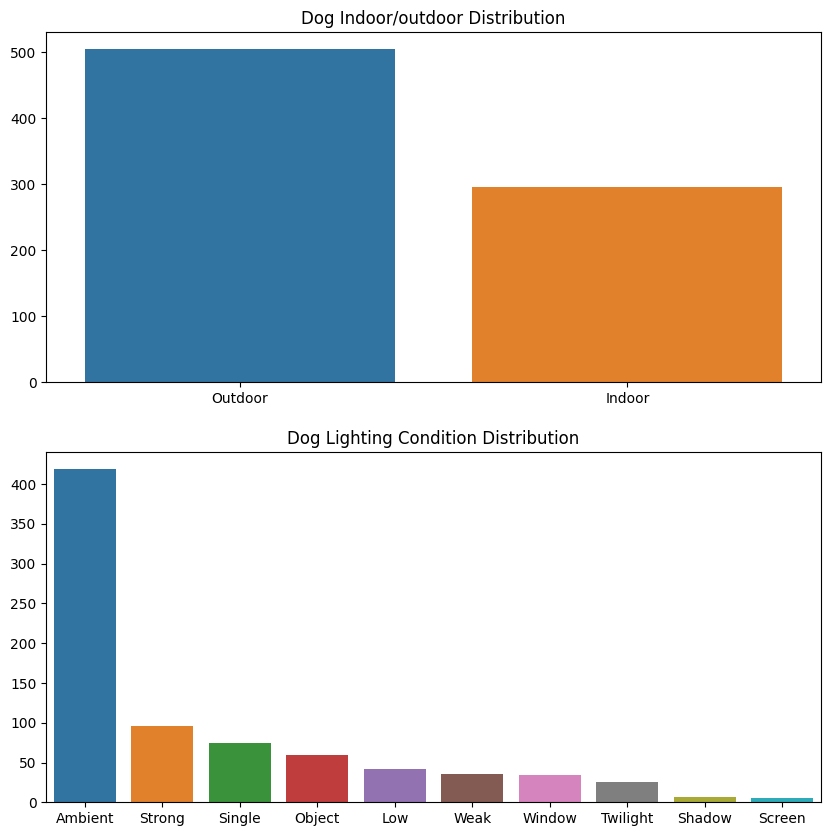

Motorbike In/Out Distribution: ['Outdoor', 'Indoor'] [486, 17]
Motorbike Lightning Condt Distribution: ['Strong', 'Ambient', 'Single', 'Weak', 'Object', 'Twilight', 'Shadow', 'Low'] [263, 94, 56, 44, 28, 14, 2, 2]


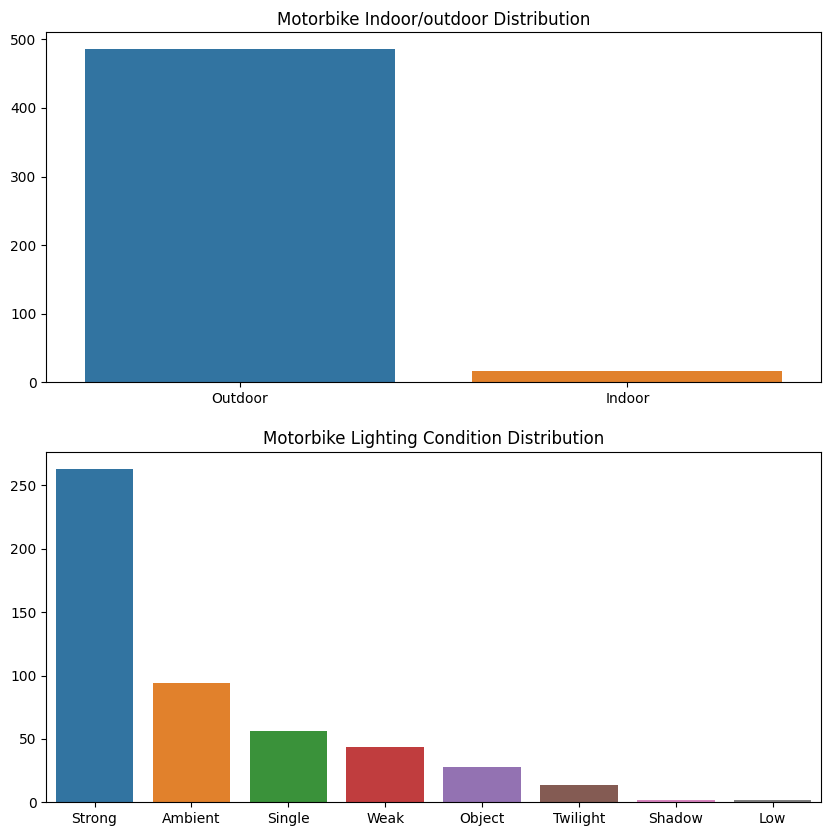

People In/Out Distribution: ['Outdoor', 'Indoor'] [396, 213]
People Lightning Condt Distribution: ['Strong', 'Ambient', 'Weak', 'Object', 'Single', 'Low', 'Window', 'Shadow', 'Twilight', 'Screen'] [181, 117, 101, 87, 73, 15, 14, 11, 8, 2]


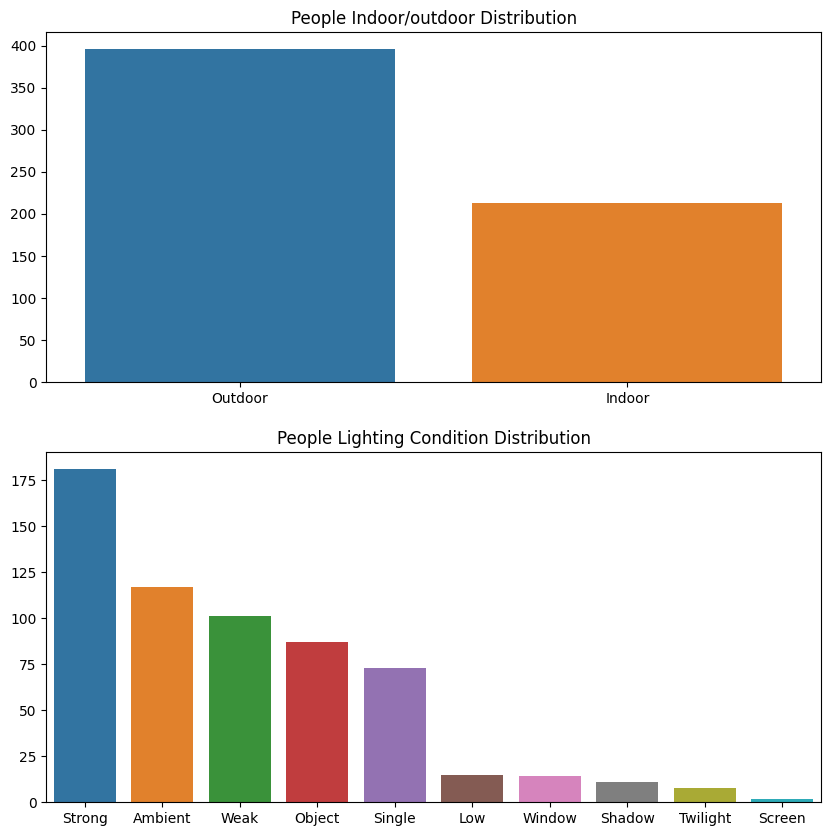

Table In/Out Distribution: ['Indoor', 'Outdoor'] [402, 103]
Table Lightning Condt Distribution: ['Ambient', 'Window', 'Weak', 'Single', 'Strong', 'Screen', 'Object', 'Low', 'Twilight', 'Shadow'] [131, 109, 70, 68, 68, 28, 14, 9, 5, 3]


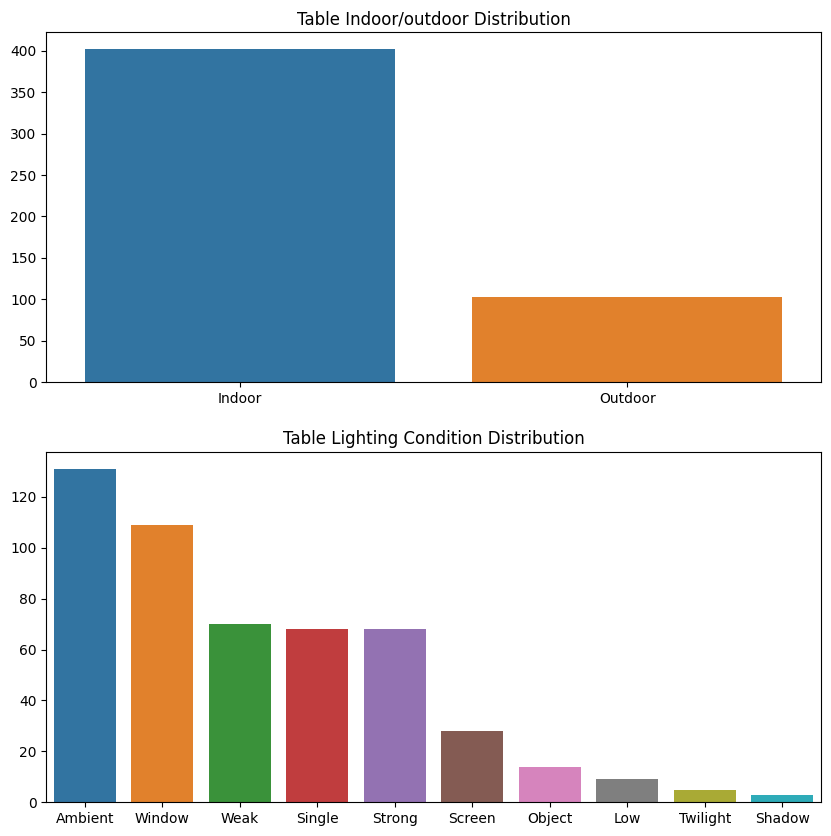

In [17]:
# global df


for label in class_dict.keys():
  df1 = df[df['Class']==label]
  in_out = dict(df1['In/Out'].value_counts())
  light_cond = dict(df1['Light'].value_counts())

  in_out_label =[]
  in_out_cnt =[]
  for i,j in in_out.items():
      in_out_label.append(in_out_dict[i])
      in_out_cnt.append(j)

  light_label = []
  light_cnt = []
  for i,j in light_cond.items():
      light_label.append(light_dict[i])
      light_cnt.append(j)

  print('{} In/Out Distribution:'.format(class_dict[label]),in_out_label,in_out_cnt)
  print('{} Lightning Condt Distribution:'.format(class_dict[label]),light_label,light_cnt)

  fig,axis = plt.subplots(2,1,figsize=(10,10))
  axis1 = sns.barplot(x=in_out_label,y=in_out_cnt,ax=axis[0])
  axis1.set_title('{} Indoor/outdoor Distribution'.format(class_dict[label]))
  axis2 = sns.barplot(x=light_label,y=light_cnt,ax=axis[1])
  axis2.set_title('{} Lighting Condition Distribution'.format(class_dict[label]))
  plt.show()

In [18]:
def plot_sample_images(label,n):
      images = []
      light = []
      global df
      df2 = df[df['Class']==label]

      for i in range(1,11):
          temp = list(df2[df2['Light']==i]['Name'])[0:n]
          if(len(temp)>2):
              for j in temp:
                  light.append(i)
                  images.append(j)

      fig, ax = plt.subplots(len(images)//n,n,figsize=(15,30),gridspec_kw={'wspace':0.01,'hspace':0.1})
      ax = ax.ravel()

      for i, img in enumerate(images):
          im_org = cv2.imread(img)
          try:
              im_resized = cv2.resize(im_org,(300,300),interpolation=cv2.INTER_LINEAR)
          except:
              continue
          ax[i].imshow(cv2.cvtColor(im_resized,cv2.COLOR_BGR2RGB),aspect='auto')
          ax[i].set_axis_off()
          ax[i].set_xlim(ax[i].get_xlim())
          ax[i].set_ylim(ax[i].get_ylim())
          ax[i].set_title(class_dict[label] + "/" + light_dict[light[i]])
      
      plt.show()

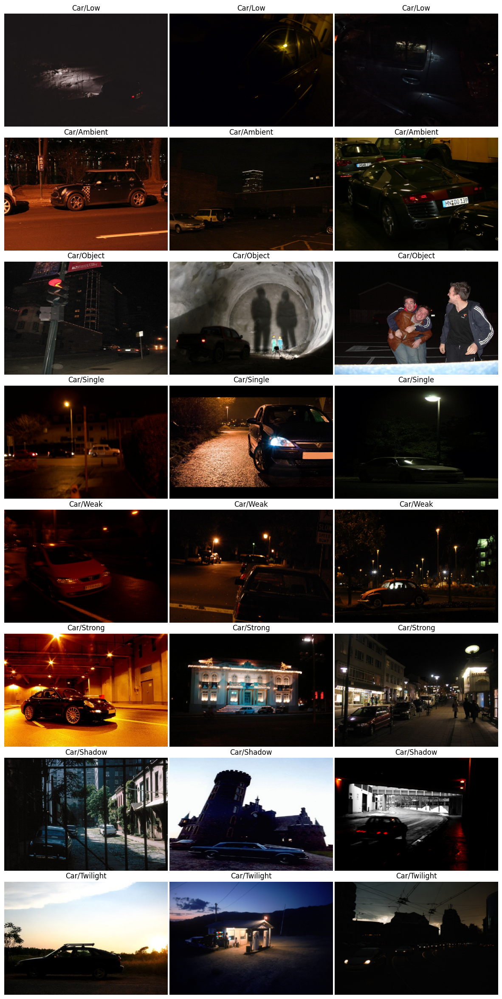

In [19]:
plot_sample_images(5,3)

In [20]:
# Prepared zip file w/ both images and annotation in one directory
!unzip "/content/drive/MyDrive/ExDark/exdark.zip"

Streaming output truncated to the last 5000 lines.
  inflating: exdark/2015_04864.jpg   
 extracting: exdark/2015_04864.jpg.txt  
  inflating: exdark/2015_04865.jpg   
 extracting: exdark/2015_04865.jpg.txt  
  inflating: exdark/2015_04866.jpg   
  inflating: exdark/2015_04866.jpg.txt  
  inflating: exdark/2015_04867.jpg   
 extracting: exdark/2015_04867.jpg.txt  
  inflating: exdark/2015_04868.jpg   
  inflating: exdark/2015_04868.jpg.txt  
  inflating: exdark/2015_04869.jpg   
  inflating: exdark/2015_04869.jpg.txt  
  inflating: exdark/2015_04870.jpg   
 extracting: exdark/2015_04870.jpg.txt  
  inflating: exdark/2015_04871.jpg   
  inflating: exdark/2015_04871.jpg.txt  
  inflating: exdark/2015_04872.jpg   
 extracting: exdark/2015_04872.jpg.txt  
  inflating: exdark/2015_04873.jpg   
  inflating: exdark/2015_04873.jpg.txt  
  inflating: exdark/2015_04874.jpg   
 extracting: exdark/2015_04874.jpg.txt  
  inflating: exdark/2015_04875.jpg   
 extracting: exdark/2015_04875.jpg.txt  
 

In [21]:
# Build Dataframe for this new combined directory
df_combined = pd.read_csv('/content/imageclasslist.txt',sep=' ',header=None,skiprows=1)
df_combined.columns = ['Name','Class','Light','In/Out','Train/Val/Test']

In [22]:
df_combined.head(5)

,Name,Class,Light,In/Out,Train/Val/Test
0,2015_00001.png,1,2,1,1
1,2015_00002.png,1,6,2,1
2,2015_00003.png,1,5,2,1
3,2015_00004.jpg,1,3,2,1
4,2015_00005.jpg,1,6,2,1


In [23]:
# /content/exdark/2015_00001.png

In [24]:
# df_combined['Name'] = '/content/exdark/' + df_combined['Name']

In [25]:
df_combined.head(5)

,Name,Class,Light,In/Out,Train/Val/Test
0,2015_00001.png,1,2,1,1
1,2015_00002.png,1,6,2,1
2,2015_00003.png,1,5,2,1
3,2015_00004.jpg,1,3,2,1
4,2015_00005.jpg,1,6,2,1


In [26]:
print(df_combined["Light"].unique())

[ 2  6  5  3 10  4  9  8  1  7]


In [27]:
# Will now construct seperate directories for each lighting condition

import os
import shutil
import pandas as pd

# images are currently located
image_directory = '/content/exdark/'

#  new directory 
new_directory = '/content/exdark_split_light'

# Create the new directory if it doesn't exist
if not os.path.exists(new_directory):
    os.makedirs(new_directory)


In [28]:
# Loop through the  dataframe and copy the images

for index, row in df.iterrows():

    # Extract the light value
    light = row['Light']
    
    # Construct the path to the subdirectory for the current light value
    subdirectory_path = os.path.join(new_directory, light_dict[light])
    
    # Create the subdirectory if it doesn't exist
    if not os.path.exists(subdirectory_path):
        os.makedirs(subdirectory_path)
    
    # Extract the filename 
    filename = os.path.basename(row['Name'])
    
    img_path = os.path.join(image_directory, filename)
    
    #destination_path = os.path.join(subdirectory_path, filename)
    # Copy the file 
    # shutil.copyfile(img_path, destination_path)

    img_name, img_ext = os.path.splitext(filename)
    txt_files = [f for f in os.listdir(image_directory) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(image_directory, txt_file)
        shutil.copy(img_path, subdirectory_path)
        shutil.copy(txt_path, subdirectory_path)
    else:
      print("error"+filename)

In [29]:
# Creating Artificially Dark Dataset with Gamma Correction
# Reference: https://pyimagesearch.com/2015/10/05/opencv-gamma-correction/

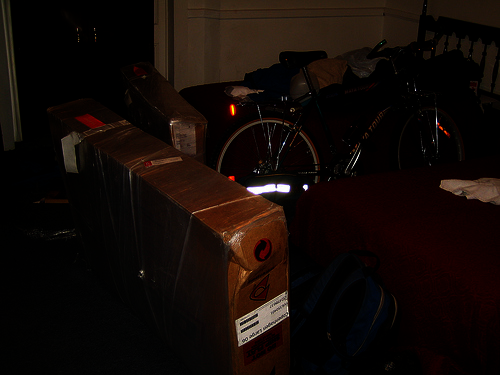

In [30]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# also known as power law trasnform

original = cv2.imread('/content/exdark/2015_00001.png')

gamma = 0.5 # fairly dark value
gamma_coef = 1.0 / gamma
# table is constructed to map every pixel val to the corrected val
table = np.array([((i / 255.0) ** gamma_coef) * 255
  for i in np.arange(0, 256)]).astype("uint8") # have to cast as floats dont work

# apply gamma correction
adjusted = cv2.LUT(original, table)
cv2_imshow(adjusted)

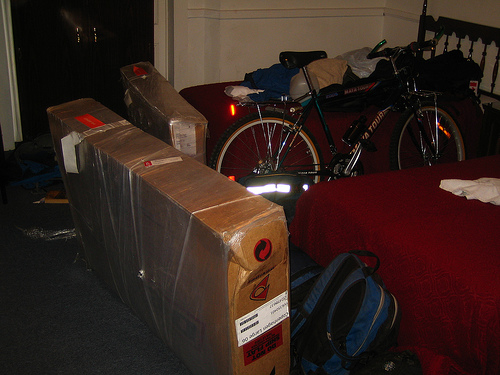

In [31]:
cv2_imshow(original)

In [32]:
# Darken images

# Define the path to the input directory
input_dir = '/content/exdark'

# Define the path to the output directory
output_dir = '/content/exdark_dark'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in img_files:
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    image = cv2.imread(input_path)
    
    # Apply gamma correction with a gamma value of 0.5
    gamma = 0.5

    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    corrected = cv2.LUT(image, table)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)
    
    

    

In [33]:
directory = '/content/exdark_dark'
files = os.listdir(directory)
num_files = len(files) / 2.0
print(f'There are {num_files} files in the directory {directory}.')

There are 7363.0 files in the directory /content/exdark_dark.


In [34]:
# experiemnt with enhancing the dark images with Multi-Scale Retinex
# referenced this blog and tweaked the code for Retinex
# https://santhalakshminarayana.github.io/blog/retinex-image-enhancement

In [35]:
!pip install opencv-python-headless

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [36]:
# function that does gamma correction as above using the lookup table with adjusted vals by power law
def adjust_gamma(image, gamma=1.0):

    invGamma = 1.0 / gamma
    table = (np.arange(0, 256) / 255.0) ** invGamma * 255
    table = np.clip(table, 0, 255).astype(np.uint8)

    return cv2.LUT(image, table)

In [37]:
!pip install numba

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [38]:
# This function is the pipeline to enhance/brighten the low-light image
# import numba as nb

# @nb.njit(parallel=True)
def msr_sigma(sigma, gray, eps):
    # Compute the logarithm of the grayscale image and the blurred image for the current sigma value (SSR)
    return np.log10(gray) - np.log10(cv2.GaussianBlur(gray, (0, 0), sigma) + eps)

def enhance_image(image_path, gamma=1.0):

    # load the image
    image = cv2.imread(image_path)

    # convert it to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # set any zero vals to 1 toa void divide by zero
    gray[gray == 0] = 1

    # apply gamma correction to enhance image using input gamma arg (1.5)
    adjusted = adjust_gamma(gray, gamma=gamma)

    # apply histogram equalization to enhance contrast
    equalized = cv2.equalizeHist(adjusted)

    # apply multi-scale retinex algorithm to enhance brightness

    # Define a list of sigma values for Gaussian blur
    sigma_scales = [15, 80, 250]

    # Initialize an array of zeros to hold the multi-scale retinex algorithm (MSR) output
    msr = np.zeros(gray.shape)

    eps = 1e-8  # a very small constant value to avoid divide by zero errors

    # get the MSR output for each sigma value
    for sigma in sigma_scales:
        msr += msr_sigma(sigma, gray, eps)

    # average MSR output over all sigma values
    msr = msr / len(sigma_scales)

    # Normalize the MSR output to the range [0, 255] and convert it to an 8-bit unsigned integer image
    msr = cv2.normalize(msr, None, 0, 255, cv2.NORM_MINMAX)
    msr = msr.astype(np.uint8)
    enhanced = cv2.cvtColor(msr, cv2.COLOR_GRAY2BGR)

    # blend the enhanced image with the original image with alpha blending
    alpha = 0.5
    beta = 1 - alpha
    blended = cv2.addWeighted(image, alpha, enhanced, beta, 0)

    return blended

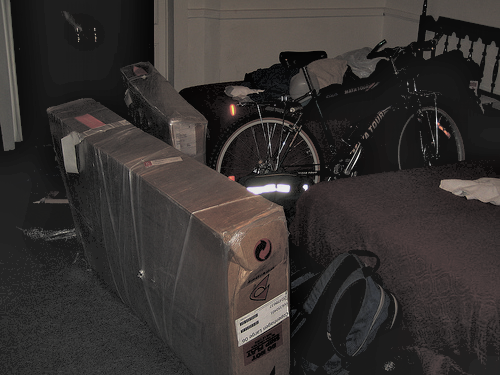

In [39]:
result = enhance_image('/content/exdark_dark/2015_00001.png', gamma=1.5)
cv2_imshow(result)

In [50]:
# Brighten images

from tqdm import tqdm

import random

# Define the path to the input directory
input_dir = '/content/exdark'

# Define the path to the output directory
output_dir = '/content/exdark_bright'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

random.shuffle(img_files)

# Get the top 500 images
img_files = img_files[:500]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
  
    
    corrected = enhance_image(input_path, gamma=1.5)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images:   3%|▎         | 200/7363 [29:44<17:45:28,  8.92s/it]


KeyboardInterrupt: ignored

In [1]:
!zip -r /content/images_bright.zip /content/exdark_bright

  adding: content/exdark_bright/ (stored 0%)
  adding: content/exdark_bright/2015_02114.jpg (deflated 0%)
  adding: content/exdark_bright/2015_05283.jpg (deflated 1%)
  adding: content/exdark_bright/2015_02739.jpg (deflated 3%)
  adding: content/exdark_bright/2015_05144.jpg (deflated 0%)
  adding: content/exdark_bright/2015_04106.jpg (deflated 0%)
  adding: content/exdark_bright/2015_03193.jpg (deflated 0%)
  adding: content/exdark_bright/2015_03498.jpg (deflated 3%)
  adding: content/exdark_bright/2015_00791.jpg (deflated 0%)
  adding: content/exdark_bright/2015_00889.jpg (deflated 0%)
  adding: content/exdark_bright/2015_07138.jpg (deflated 1%)
  adding: content/exdark_bright/2015_01370.jpg (deflated 1%)
  adding: content/exdark_bright/2015_06037.jpg (deflated 2%)
  adding: content/exdark_bright/2015_00496.jpg (deflated 0%)
  adding: content/exdark_bright/2015_04249.jpg (deflated 2%)
  adding: content/exdark_bright/2015_06208.png (deflated 2%)
  adding: content/exdark_bright/2015_065

In [45]:
!unzip '/content/images_bright.zip' -d "/"

Archive:  /content/images_bright.zip
   creating: /content/exdark_bright/
  inflating: /content/exdark_bright/2015_02114.jpg  
  inflating: /content/exdark_bright/2015_05283.jpg  
  inflating: /content/exdark_bright/2015_02739.jpg  
  inflating: /content/exdark_bright/2015_05144.jpg  
  inflating: /content/exdark_bright/2015_04106.jpg  
  inflating: /content/exdark_bright/2015_03193.jpg  
  inflating: /content/exdark_bright/2015_03498.jpg  
  inflating: /content/exdark_bright/2015_00791.jpg  
  inflating: /content/exdark_bright/2015_00889.jpg  
  inflating: /content/exdark_bright/2015_07138.jpg  
  inflating: /content/exdark_bright/2015_01370.jpg  
  inflating: /content/exdark_bright/2015_06037.jpg  
  inflating: /content/exdark_bright/2015_00496.jpg  
  inflating: /content/exdark_bright/2015_04249.jpg  
  inflating: /content/exdark_bright/2015_06208.png  
  inflating: /content/exdark_bright/2015_06554.jpg  
  inflating: /content/exdark_bright/2015_01608.jpg  
  inflating: /content/exd

In [41]:
# Going to try and enhance images using Mirenet
# Referenced / tweaked this notebook on kaggle:
# https://www.kaggle.com/code/nulldata/low-light-image-enhancement-with-keras-mirnet

In [87]:
! pip install keras
! pip install huggingface_hub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [88]:
import PIL
from PIL import Image 
from huggingface_hub import from_pretrained_keras 
import keras
from keras.utils import load_img, img_to_array

In [89]:
mirnet_model = from_pretrained_keras("keras-io/lowlight-enhance-mirnet", compile=False)

config.json not found in HuggingFace Hub.


Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


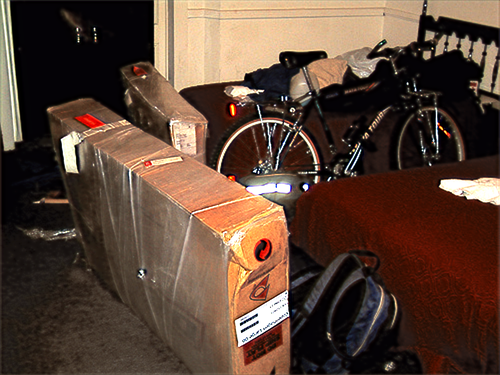

In [98]:
low_light_img = Image.open('/content/exdark_dark/2015_00001.png').convert('RGB')
low_light_img = low_light_img.resize((1024,1024),Image.LANCZOS)
image = img_to_array(low_light_img)
image = image.astype('float32') / 255.0
image = np.expand_dims(image, axis = 0)
output = mirnet_model.predict(image) # model inference to enhance the low light 
output_image = output[0] * 255.0
output_image = output_image.clip(0,255)
output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))
output_image = np.uint32(output_image)
(Image.fromarray(output_image.astype('uint8'),'RGB')).resize((500,375),Image.LANCZOS)
# img.save("output.jpg")

In [94]:
input_dir = '/content/exdark'
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]
# Get the first 500 images
img_files = img_files[:500]

# Initialize max width and height to zero
max_width = 0
max_height = 0

# Iterate over the images and get the maximum width and height
for img_file in img_files:
    img_path = os.path.join(input_dir, img_file)
    with Image.open(img_path) as img:
        width, height = img.size
        print(img.size)
        if width > max_width:
            max_width = width
        if height > max_height:
            max_height = height

max_size = (max_width, max_height)
print(f"The maximum size of the first 500 images is {max_size}")

(640, 480)
(640, 480)
(900, 675)
(637, 397)
(640, 427)
(500, 375)
(949, 841)
(500, 375)
(509, 339)
(500, 240)
(640, 427)
(1600, 1062)
(750, 1000)
(536, 800)
(1920, 1072)
(640, 426)
(480, 640)
(640, 427)
(500, 375)
(414, 414)
(640, 480)
(500, 375)
(640, 480)
(1095, 730)
(640, 426)
(900, 600)
(427, 640)
(640, 425)
(397, 297)
(1095, 730)
(375, 500)
(640, 427)
(1024, 683)
(480, 360)
(335, 511)
(640, 358)
(500, 375)
(500, 375)
(2291, 1527)
(900, 602)
(500, 236)
(600, 450)
(500, 375)
(730, 1095)
(1024, 683)
(640, 427)
(640, 427)
(720, 514)
(900, 672)
(375, 500)
(507, 338)
(720, 404)
(1024, 768)
(640, 426)
(507, 338)
(600, 450)
(477, 358)
(2448, 3264)
(338, 507)
(524, 327)
(640, 480)
(774, 1032)
(1024, 683)
(1024, 625)
(600, 800)
(319, 352)
(1024, 576)
(500, 375)
(375, 500)
(1279, 647)
(500, 375)
(900, 600)
(640, 482)
(696, 454)
(507, 337)
(1599, 874)
(640, 426)
(640, 429)
(500, 375)
(1280, 532)
(1600, 1509)
(1024, 664)
(640, 480)
(640, 480)
(2448, 3264)
(500, 332)
(337, 507)
(338, 507)
(777,

In [100]:
# Enhance images with Mirnet

# Define the path to the input directory
input_dir = '/content/exdark'

# Define the path to the output directory
output_dir = '/content/exdark_bright_mirnet'

from tqdm import tqdm
import random

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

random.shuffle(img_files)
# Get the top 500 images
img_files = img_files[:500]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    input_image = Image.open(input_path).convert('RGB')
    #save height width
    input_width, input_height = input_image.size
    # resize to set size
    input_image = input_image.resize((1024,1024),Image.LANCZOS)
    # convert image to np array
    image = img_to_array(input_image)
    # get betwenn 0 and 1
    image = image.astype('float32') / 255.0
    # batch of 1
    image = np.expand_dims(image, axis = 0)
    # predict inference
    output = mirnet_model.predict(image) 

    # 0 to 255
    output_image = output[0] * 255.0
    output_image = output_image.clip(0,255)
    # reshape
    output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))
    # back to int
    output_image = np.uint32(output_image)

    output_image = (Image.fromarray(output_image.astype('uint8'),'RGB'))
    output_image = output_image.resize((input_width,input_height),Image.LANCZOS)
    
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        output_image.save(output_path)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images:   0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


Processing images:   0%|          | 1/500 [00:05<44:24,  5.34s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   0%|          | 2/500 [00:10<44:24,  5.35s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   1%|          | 3/500 [00:14<39:35,  4.78s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   1%|          | 4/500 [00:20<41:16,  4.99s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   1%|          | 5/500 [00:24<38:49,  4.71s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   1%|          | 6/500 [00:28<37:11,  4.52s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   1%|▏         | 7/500 [00:33<39:28,  4.80s/it]

1/1 [==============================] - 3s 3s/step


Processing images:   2%|▏         | 8/500 [00:39<41:03,  5.01s/it]

1/1 [==============================] - 3s 3s/step


Processing images:   2%|▏         | 9/500 [00:43<38:49,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   2%|▏         | 10/500 [00:48<40:05,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   2%|▏         | 11/500 [00:54<40:55,  5.02s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   2%|▏         | 12/500 [00:59<41:56,  5.16s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   3%|▎         | 13/500 [01:03<39:38,  4.88s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   3%|▎         | 14/500 [01:07<37:43,  4.66s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   3%|▎         | 15/500 [01:14<42:10,  5.22s/it]

1/1 [==============================] - 3s 3s/step


Processing images:   3%|▎         | 16/500 [01:19<42:15,  5.24s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   3%|▎         | 17/500 [01:23<39:30,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   4%|▎         | 18/500 [01:29<40:19,  5.02s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   4%|▍         | 19/500 [01:34<40:50,  5.10s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   4%|▍         | 20/500 [01:39<41:18,  5.16s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   4%|▍         | 21/500 [01:43<38:50,  4.87s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   4%|▍         | 22/500 [01:47<36:59,  4.64s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   5%|▍         | 23/500 [01:53<38:30,  4.84s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   5%|▍         | 24/500 [01:58<39:42,  5.01s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   5%|▌         | 25/500 [02:02<37:35,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   5%|▌         | 26/500 [02:08<38:48,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   5%|▌         | 27/500 [02:13<39:37,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   6%|▌         | 28/500 [02:18<40:13,  5.11s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   6%|▌         | 29/500 [02:24<40:37,  5.18s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   6%|▌         | 30/500 [02:28<38:07,  4.87s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   6%|▌         | 31/500 [02:33<39:01,  4.99s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   6%|▋         | 32/500 [02:37<36:53,  4.73s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   7%|▋         | 33/500 [02:41<35:22,  4.54s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   7%|▋         | 34/500 [02:46<36:59,  4.76s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   7%|▋         | 35/500 [02:51<35:23,  4.57s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   7%|▋         | 36/500 [02:56<37:00,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   7%|▋         | 37/500 [03:01<38:03,  4.93s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   8%|▊         | 38/500 [03:05<36:05,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   8%|▊         | 39/500 [03:10<35:13,  4.58s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   8%|▊         | 40/500 [03:14<34:07,  4.45s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   8%|▊         | 41/500 [03:19<35:54,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   8%|▊         | 42/500 [03:23<34:32,  4.53s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   9%|▊         | 43/500 [03:28<36:09,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   9%|▉         | 44/500 [03:33<34:40,  4.56s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   9%|▉         | 45/500 [03:38<36:17,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   9%|▉         | 46/500 [03:43<37:27,  4.95s/it]

1/1 [==============================] - 2s 2s/step


Processing images:   9%|▉         | 47/500 [03:48<38:07,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  10%|▉         | 48/500 [03:53<36:13,  4.81s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  10%|▉         | 49/500 [03:57<34:51,  4.64s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  10%|█         | 50/500 [04:02<36:12,  4.83s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  10%|█         | 51/500 [04:08<37:12,  4.97s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  10%|█         | 52/500 [04:12<35:33,  4.76s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  11%|█         | 53/500 [04:16<34:02,  4.57s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  11%|█         | 54/500 [04:21<35:35,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  11%|█         | 55/500 [04:25<34:06,  4.60s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  11%|█         | 56/500 [04:30<32:57,  4.45s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  11%|█▏        | 57/500 [04:35<34:40,  4.70s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  12%|█▏        | 58/500 [04:39<34:31,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  12%|█▏        | 59/500 [04:44<33:08,  4.51s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  12%|█▏        | 60/500 [04:49<34:46,  4.74s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  12%|█▏        | 61/500 [04:53<33:20,  4.56s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  12%|█▏        | 62/500 [04:57<32:22,  4.44s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  13%|█▎        | 63/500 [05:01<31:42,  4.35s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  13%|█▎        | 64/500 [05:05<31:16,  4.30s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  13%|█▎        | 65/500 [05:11<33:21,  4.60s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  13%|█▎        | 66/500 [05:16<34:44,  4.80s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  13%|█▎        | 67/500 [05:20<33:11,  4.60s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  14%|█▎        | 68/500 [05:25<34:36,  4.81s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  14%|█▍        | 69/500 [05:30<33:12,  4.62s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  14%|█▍        | 70/500 [05:34<32:44,  4.57s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  14%|█▍        | 71/500 [05:38<31:41,  4.43s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  14%|█▍        | 72/500 [05:43<33:27,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  15%|█▍        | 73/500 [05:48<32:08,  4.52s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  15%|█▍        | 74/500 [05:52<31:07,  4.38s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  15%|█▌        | 75/500 [05:56<30:33,  4.31s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  15%|█▌        | 76/500 [06:01<33:13,  4.70s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  15%|█▌        | 77/500 [06:06<31:53,  4.52s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  16%|█▌        | 78/500 [06:11<33:25,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  16%|█▌        | 79/500 [06:15<32:01,  4.56s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  16%|█▌        | 80/500 [06:19<31:31,  4.50s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  16%|█▌        | 81/500 [06:24<31:07,  4.46s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  16%|█▋        | 82/500 [06:28<30:28,  4.37s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  17%|█▋        | 83/500 [06:33<32:18,  4.65s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  17%|█▋        | 84/500 [06:37<31:07,  4.49s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  17%|█▋        | 85/500 [06:43<34:12,  4.95s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  17%|█▋        | 86/500 [06:47<32:22,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  17%|█▋        | 87/500 [06:53<33:32,  4.87s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  18%|█▊        | 88/500 [06:57<31:54,  4.65s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  18%|█▊        | 89/500 [07:02<33:12,  4.85s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  18%|█▊        | 90/500 [07:07<34:10,  5.00s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  18%|█▊        | 91/500 [07:13<34:47,  5.10s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  18%|█▊        | 92/500 [07:18<35:07,  5.17s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  19%|█▊        | 93/500 [07:23<35:23,  5.22s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  19%|█▉        | 94/500 [07:28<33:10,  4.90s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  19%|█▉        | 95/500 [07:33<33:50,  5.01s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  19%|█▉        | 96/500 [07:37<31:57,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  19%|█▉        | 97/500 [07:42<33:00,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  20%|█▉        | 98/500 [07:48<33:48,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  20%|█▉        | 99/500 [07:53<34:12,  5.12s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  20%|██        | 100/500 [07:58<34:28,  5.17s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  20%|██        | 101/500 [08:02<32:29,  4.88s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  20%|██        | 102/500 [08:07<30:54,  4.66s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  21%|██        | 103/500 [08:12<32:02,  4.84s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  21%|██        | 104/500 [08:16<30:34,  4.63s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  21%|██        | 105/500 [08:21<31:47,  4.83s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  21%|██        | 106/500 [08:27<32:36,  4.97s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  21%|██▏       | 107/500 [08:32<33:09,  5.06s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  22%|██▏       | 108/500 [08:37<33:34,  5.14s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  22%|██▏       | 109/500 [08:43<33:53,  5.20s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  22%|██▏       | 110/500 [08:47<31:34,  4.86s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  22%|██▏       | 111/500 [08:52<32:18,  4.98s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  22%|██▏       | 112/500 [08:56<30:33,  4.73s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  23%|██▎       | 113/500 [09:00<29:10,  4.52s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  23%|██▎       | 114/500 [09:05<30:33,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  23%|██▎       | 115/500 [09:11<31:31,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  23%|██▎       | 116/500 [09:15<30:39,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  23%|██▎       | 117/500 [09:19<29:24,  4.61s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  24%|██▎       | 118/500 [09:23<28:26,  4.47s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  24%|██▍       | 119/500 [09:28<27:54,  4.39s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  24%|██▍       | 120/500 [09:33<29:35,  4.67s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  24%|██▍       | 121/500 [09:37<28:29,  4.51s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  24%|██▍       | 122/500 [09:42<29:53,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  25%|██▍       | 123/500 [09:48<31:00,  4.94s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  25%|██▍       | 124/500 [09:52<29:42,  4.74s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  25%|██▌       | 125/500 [09:56<28:27,  4.55s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  25%|██▌       | 126/500 [10:01<29:22,  4.71s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  25%|██▌       | 127/500 [10:05<28:11,  4.54s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  26%|██▌       | 128/500 [10:11<29:43,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  26%|██▌       | 129/500 [10:15<28:28,  4.61s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  26%|██▌       | 130/500 [10:20<29:42,  4.82s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  26%|██▌       | 131/500 [10:26<30:40,  4.99s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  26%|██▋       | 132/500 [10:31<30:21,  4.95s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  27%|██▋       | 133/500 [10:36<30:52,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  27%|██▋       | 134/500 [10:41<31:12,  5.12s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  27%|██▋       | 135/500 [10:45<29:13,  4.80s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  27%|██▋       | 136/500 [10:51<30:12,  4.98s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  27%|██▋       | 137/500 [10:55<28:36,  4.73s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  28%|██▊       | 138/500 [10:59<27:26,  4.55s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  28%|██▊       | 139/500 [11:05<29:29,  4.90s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  28%|██▊       | 140/500 [11:10<30:24,  5.07s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  28%|██▊       | 141/500 [11:15<30:44,  5.14s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  28%|██▊       | 142/500 [11:21<30:57,  5.19s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  29%|██▊       | 143/500 [11:25<29:04,  4.89s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  29%|██▉       | 144/500 [11:29<27:39,  4.66s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  29%|██▉       | 145/500 [11:34<28:42,  4.85s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  29%|██▉       | 146/500 [11:40<29:30,  5.00s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  29%|██▉       | 147/500 [11:45<29:57,  5.09s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  30%|██▉       | 148/500 [11:49<28:15,  4.82s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  30%|██▉       | 149/500 [11:54<29:03,  4.97s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  30%|███       | 150/500 [12:00<29:35,  5.07s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  30%|███       | 151/500 [12:05<29:57,  5.15s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  30%|███       | 152/500 [12:09<28:05,  4.84s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  31%|███       | 153/500 [12:14<28:48,  4.98s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  31%|███       | 154/500 [12:19<28:26,  4.93s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  31%|███       | 155/500 [12:24<27:55,  4.86s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  31%|███       | 156/500 [12:29<28:35,  4.99s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  31%|███▏      | 157/500 [12:33<27:13,  4.76s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  32%|███▏      | 158/500 [12:39<28:03,  4.92s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  32%|███▏      | 159/500 [12:44<28:42,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  32%|███▏      | 160/500 [12:49<27:58,  4.94s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  32%|███▏      | 161/500 [12:54<28:30,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  32%|███▏      | 162/500 [12:58<26:56,  4.78s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  33%|███▎      | 163/500 [13:04<27:41,  4.93s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  33%|███▎      | 164/500 [13:09<28:10,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  33%|███▎      | 165/500 [13:13<26:36,  4.77s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  33%|███▎      | 166/500 [13:17<25:28,  4.58s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  33%|███▎      | 167/500 [13:22<26:42,  4.81s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  34%|███▎      | 168/500 [13:27<25:27,  4.60s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  34%|███▍      | 169/500 [13:31<24:36,  4.46s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  34%|███▍      | 170/500 [13:36<25:57,  4.72s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  34%|███▍      | 171/500 [13:40<25:15,  4.61s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  34%|███▍      | 172/500 [13:46<26:15,  4.80s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  35%|███▍      | 173/500 [13:51<26:57,  4.95s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  35%|███▍      | 174/500 [13:55<25:31,  4.70s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  35%|███▌      | 175/500 [13:59<24:35,  4.54s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  35%|███▌      | 176/500 [14:04<25:42,  4.76s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  35%|███▌      | 177/500 [14:10<26:32,  4.93s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  36%|███▌      | 178/500 [14:15<27:06,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  36%|███▌      | 179/500 [14:20<27:30,  5.14s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  36%|███▌      | 180/500 [14:26<27:57,  5.24s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  36%|███▌      | 181/500 [14:31<27:58,  5.26s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  36%|███▋      | 182/500 [14:35<26:03,  4.92s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  37%|███▋      | 183/500 [14:39<24:43,  4.68s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  37%|███▋      | 184/500 [14:45<26:27,  5.02s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  37%|███▋      | 185/500 [14:51<28:03,  5.35s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  37%|███▋      | 186/500 [14:57<27:52,  5.33s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  37%|███▋      | 187/500 [15:02<27:49,  5.34s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  38%|███▊      | 188/500 [15:07<27:42,  5.33s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  38%|███▊      | 189/500 [15:12<25:51,  4.99s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  38%|███▊      | 190/500 [15:17<26:12,  5.07s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  38%|███▊      | 191/500 [15:22<25:31,  4.96s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  38%|███▊      | 192/500 [15:26<24:14,  4.72s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  39%|███▊      | 193/500 [15:31<25:04,  4.90s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  39%|███▉      | 194/500 [15:36<25:38,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  39%|███▉      | 195/500 [15:40<24:14,  4.77s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  39%|███▉      | 196/500 [15:46<24:55,  4.92s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  39%|███▉      | 197/500 [15:51<25:22,  5.02s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  40%|███▉      | 198/500 [15:55<23:54,  4.75s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  40%|███▉      | 199/500 [16:00<24:40,  4.92s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  40%|████      | 200/500 [16:05<23:27,  4.69s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  40%|████      | 201/500 [16:11<25:17,  5.07s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  40%|████      | 202/500 [16:16<25:33,  5.14s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  41%|████      | 203/500 [16:21<26:06,  5.28s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  41%|████      | 204/500 [16:27<26:03,  5.28s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  41%|████      | 205/500 [16:31<24:17,  4.94s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  41%|████      | 206/500 [16:35<23:03,  4.71s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  41%|████▏     | 207/500 [16:40<23:50,  4.88s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  42%|████▏     | 208/500 [16:44<22:40,  4.66s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  42%|████▏     | 209/500 [16:50<23:36,  4.87s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  42%|████▏     | 210/500 [16:55<24:09,  5.00s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  42%|████▏     | 211/500 [17:01<24:37,  5.11s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  42%|████▏     | 212/500 [17:06<24:45,  5.16s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  43%|████▎     | 213/500 [17:10<23:14,  4.86s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  43%|████▎     | 214/500 [17:15<23:51,  5.00s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  43%|████▎     | 215/500 [17:19<22:30,  4.74s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  43%|████▎     | 216/500 [17:25<23:13,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  43%|████▎     | 217/500 [17:30<23:44,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  44%|████▎     | 218/500 [17:35<24:05,  5.13s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  44%|████▍     | 219/500 [17:40<22:48,  4.87s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  44%|████▍     | 220/500 [17:44<21:38,  4.64s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  44%|████▍     | 221/500 [17:49<22:28,  4.83s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  44%|████▍     | 222/500 [17:54<21:53,  4.72s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  45%|████▍     | 223/500 [17:59<22:40,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  45%|████▍     | 224/500 [18:04<23:08,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  45%|████▌     | 225/500 [18:08<21:51,  4.77s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  45%|████▌     | 226/500 [18:12<20:55,  4.58s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  45%|████▌     | 227/500 [18:18<21:52,  4.81s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  46%|████▌     | 228/500 [18:22<21:00,  4.64s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  46%|████▌     | 229/500 [18:28<22:11,  4.91s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  46%|████▌     | 230/500 [18:33<22:42,  5.05s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  46%|████▌     | 231/500 [18:38<23:02,  5.14s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  46%|████▋     | 232/500 [18:44<23:09,  5.19s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  47%|████▋     | 233/500 [18:48<21:45,  4.89s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  47%|████▋     | 234/500 [18:53<22:13,  5.01s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  47%|████▋     | 235/500 [18:58<22:29,  5.09s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  47%|████▋     | 236/500 [19:03<21:06,  4.80s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  47%|████▋     | 237/500 [19:07<20:11,  4.61s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  48%|████▊     | 238/500 [19:11<19:26,  4.45s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  48%|████▊     | 239/500 [19:16<20:32,  4.72s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  48%|████▊     | 240/500 [19:20<19:40,  4.54s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  48%|████▊     | 241/500 [19:26<20:34,  4.77s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  48%|████▊     | 242/500 [19:30<19:41,  4.58s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  49%|████▊     | 243/500 [19:35<20:30,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  49%|████▉     | 244/500 [19:39<19:34,  4.59s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  49%|████▉     | 245/500 [19:43<18:52,  4.44s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  49%|████▉     | 246/500 [19:47<18:23,  4.34s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  49%|████▉     | 247/500 [19:53<19:31,  4.63s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  50%|████▉     | 248/500 [19:57<18:47,  4.48s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  50%|████▉     | 249/500 [20:02<19:44,  4.72s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  50%|█████     | 250/500 [20:06<18:55,  4.54s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  50%|█████     | 251/500 [20:12<20:00,  4.82s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  50%|█████     | 252/500 [20:16<19:06,  4.62s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  51%|█████     | 253/500 [20:21<19:54,  4.84s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  51%|█████     | 254/500 [20:25<18:56,  4.62s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  51%|█████     | 255/500 [20:31<19:53,  4.87s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  51%|█████     | 256/500 [20:36<20:51,  5.13s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  51%|█████▏    | 257/500 [20:44<23:14,  5.74s/it]

1/1 [==============================] - 3s 3s/step


Processing images:  52%|█████▏    | 258/500 [20:48<21:18,  5.28s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  52%|█████▏    | 259/500 [20:52<19:53,  4.95s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  52%|█████▏    | 260/500 [20:56<18:48,  4.70s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  52%|█████▏    | 261/500 [21:01<19:26,  4.88s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  52%|█████▏    | 262/500 [21:07<19:53,  5.01s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  53%|█████▎    | 263/500 [21:12<20:08,  5.10s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  53%|█████▎    | 264/500 [21:17<20:20,  5.17s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  53%|█████▎    | 265/500 [21:22<19:12,  4.90s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  53%|█████▎    | 266/500 [21:27<19:35,  5.03s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  53%|█████▎    | 267/500 [21:31<18:31,  4.77s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  54%|█████▎    | 268/500 [21:35<17:41,  4.58s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  54%|█████▍    | 269/500 [21:40<18:26,  4.79s/it]

1/1 [==============================] - 2s 2s/step


Processing images:  54%|█████▍    | 270/500 [21:47<18:33,  4.84s/it]


KeyboardInterrupt: ignored

In [101]:
!zip -r /content/images_bright_mirnet.zip /content/exdark_bright_mirnet

  adding: content/exdark_bright_mirnet/ (stored 0%)
  adding: content/exdark_bright_mirnet/2015_02114.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_05283.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_02739.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_05144.jpg (deflated 1%)
  adding: content/exdark_bright_mirnet/2015_04106.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_03193.jpg (deflated 1%)
  adding: content/exdark_bright_mirnet/2015_03498.jpg (deflated 5%)
  adding: content/exdark_bright_mirnet/2015_00791.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_00889.jpg (deflated 2%)
  adding: content/exdark_bright_mirnet/2015_07138.jpg (deflated 1%)
  adding: content/exdark_bright_mirnet/2015_01370.jpg (deflated 6%)
  adding: content/exdark_bright_mirnet/2015_06037.jpg (deflated 2%)
  adding: content/exdark_bright_mirnet/2015_00496.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/2015_04249.jpg (deflated 

In [44]:
!unzip '/content/images_bright_mirnet.zip' -d "/"

Archive:  /content/images_bright_mirnet.zip
   creating: /content/exdark_bright_mirnet/
  inflating: /content/exdark_bright_mirnet/2015_02114.jpg  
  inflating: /content/exdark_bright_mirnet/2015_05283.jpg  
  inflating: /content/exdark_bright_mirnet/2015_02739.jpg  
  inflating: /content/exdark_bright_mirnet/2015_05144.jpg  
  inflating: /content/exdark_bright_mirnet/2015_04106.jpg  
  inflating: /content/exdark_bright_mirnet/2015_03193.jpg  
  inflating: /content/exdark_bright_mirnet/2015_03498.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00791.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00889.jpg  
  inflating: /content/exdark_bright_mirnet/2015_07138.jpg  
  inflating: /content/exdark_bright_mirnet/2015_01370.jpg  
  inflating: /content/exdark_bright_mirnet/2015_06037.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00496.jpg  
  inflating: /content/exdark_bright_mirnet/2015_04249.jpg  
  inflating: /content/exdark_bright_mirnet/2015_06208.png  
  inflating:

Height: 363
Width: 640
Channels: 3


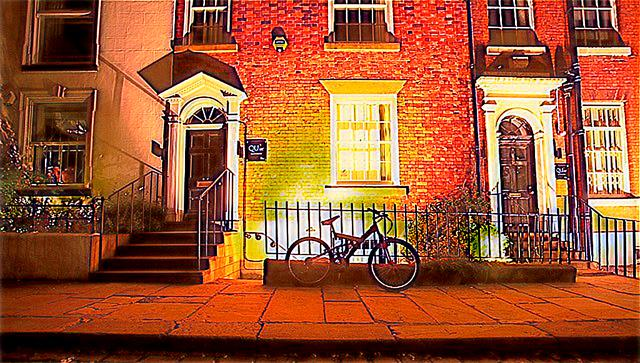

In [46]:
# Load the image
original = cv2.imread('/content/exdark_bright_mirnet/2015_00020.jpg')

# Check the shape of the image
height, width, channels = original.shape

print("Height:", height)
print("Width:", width)
print("Channels:", channels)

cv2_imshow(original)

In [ ]:
# Need to run the enhancement to 500 images for both mirnet and our pipleline, limit dark to 500 

In [47]:
# Running the data we prepared to finetune Faster RCNN from Dectron 2 (object detection library) from Facebook

In [48]:
# Install detectron

In [49]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 9.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=3d1e5099fa33847b10aa73b88735d16a5e3a30f24190c8c2e1695f6e9900f9c1
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatibl

In [50]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [51]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [52]:
import os
import random
import shutil

# Set the path to the directory containing the images and annotations
data_dir = '/content/exdark'

# Create two new directories for train and test data
train_dir = os.path.join(data_dir, 'train')
test_dir = os.path.join(data_dir, 'test')
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Get a list of all image files
img_files = [f for f in os.listdir(data_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(data_dir, f))]

# Shuffle the list of image files
random.shuffle(img_files)

print(len(img_files))

7363


In [53]:
# Split the data into training and testing sets
split_idx = int(0.8 * len(img_files))
train_files = img_files[:split_idx]
test_files = img_files[split_idx:]


# Copy the training files and corresponding annotation files to the train directory
for img_file in train_files:
    img_path = os.path.join(data_dir, img_file)
    img_name, img_ext = os.path.splitext(img_file)
    txt_files = [f for f in os.listdir(data_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(data_dir, txt_file)
        shutil.copy(img_path, train_dir)
        shutil.copy(txt_path, train_dir)
    else:
      print("error" +img_file)

# Copy the testing files and corresponding annotation files to the test directory
for img_file in test_files:
    img_path = os.path.join(data_dir, img_file)
    img_name, img_ext = os.path.splitext(img_file)
    txt_files = [f for f in os.listdir(data_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(data_dir, txt_file)
        shutil.copy(img_path, test_dir)
        shutil.copy(txt_path, test_dir)
    else:
      print("error" +img_file)

In [61]:
import glob
import os
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode

In [71]:
# Reference: https://github.com/Yashsshah909/Object-detection-of-low-light-images-using-the-Exclusively-Dark-ExDark-dataset./blob/main/Fast_RCNN_and_Faster_RCNN.ipynb
classes = {"0": "bicycle", "1" : "boat", "2" : "bottle" , "3" : "bus", "4":"car", "5":"cat" ,"6" : "chair" , "7":"cup","8":"dog","9":"motorbike","10":"people","11":"table"}
key_list = list(classes.keys())
val_list = list(classes.values())

def convert_data_to_dict(img_dir):
    # Get all annotation files in the specified directory
    annotation_files = glob.glob(img_dir +"/*.txt")
    result = []
    # Loop over each file
    for idx, file_path in enumerate(annotation_files):
        with open(file_path, "r") as f_o:
            lines = f_o.readlines()

            # Remove the first line if it matches the specified string
            if '% bbGt version=3\n' in lines:
                lines.remove('% bbGt version=3\n')
        
            data = {}
            # list to store the bounding boxes for this image
            bboxes = []
       
            for line in lines:
             
                j = line.split(' ')

                # dictionary to store the bounding box information
                box = {}

                # check if there are at least 4 elements in the split line
                if j != None and len(j) >= 4:

                    # Store the bounding box coordinates as a list
                    box['bbox'] = [int(j[1]), int(j[2]), int(j[3]), int(j[4])]

                    # Specify that the bounding box coordinates are in (x, y, w, h) format
                    box['bbox_mode'] = BoxMode.XYWH_ABS

                    # map the class name to its corresponding integer ID and store it in the dictionary
                    box['category_id'] = int(key_list[val_list.index(j[0].lower())])
                    bboxes.append(box)

            # Get the image file path by replacing the file extension of the annotation file
            p = file_path.split('.')[0] + '.' + file_path.split('.')[1]
            
            if os.path.exists(p):
                img = cv2.imread(p)

                # Store the list of bounding boxes 
                data['annotations'] = bboxes

                # Store the index of the image as its ID
                data['image_id'] = idx

                data['file_name'] = p

                if img is not None:
                    data['width'] = img.shape[1]
                    data['height'] = img.shape[0]

        # Check if the dictionary contains all required keys
        if len(data) == 5:
            # Append the dictionary to results
            result.append(data)
    # Return the list of dictionaries 
    return result

In [76]:
# # # Unregister the dataset from the DatasetCatalog
# DatasetCatalog.remove("boardetect_train")
# DatasetCatalog.remove("boardetect_test")

# # Unregister the metadata for the dataset from the MetadataCatalog
# MetadataCatalog.remove("boardetect_train")
# MetadataCatalog.remove("boardetect_test")

In [77]:
# list_classes = list(reverse_class_dict.keys())

# Regsiter all datasets

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark/" + d))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=val_list)
  board_metadata = MetadataCatalog.get("boardetect_train")

for d in ["Ambient", "Low", "Object", "Screen", "Shadow", "Single", "Strong", "Twilight", "Weak", "Window"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark_split_light/" + d))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=val_list)
  board_metadata = MetadataCatalog.get("boardetect_Ambient")

for d in ["bright"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark_bright/"))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=val_list)
  board_metadata = MetadataCatalog.get("boardetect_bright")

for d in ["bright_mirnet"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark_bright_mirnet/"))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=val_list)
  board_metadata = MetadataCatalog.get("boardetect_bright_mirnet")

for d in ["dark"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark_dark/"))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=val_list)
  board_metadata = MetadataCatalog.get("boardetect_dark")



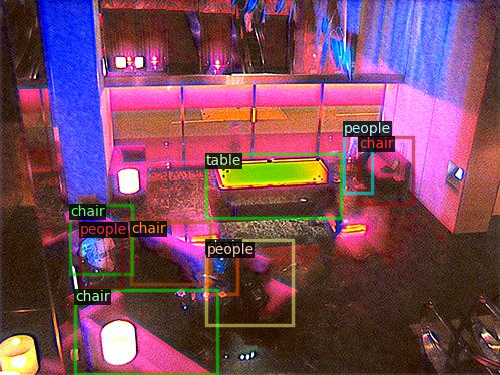

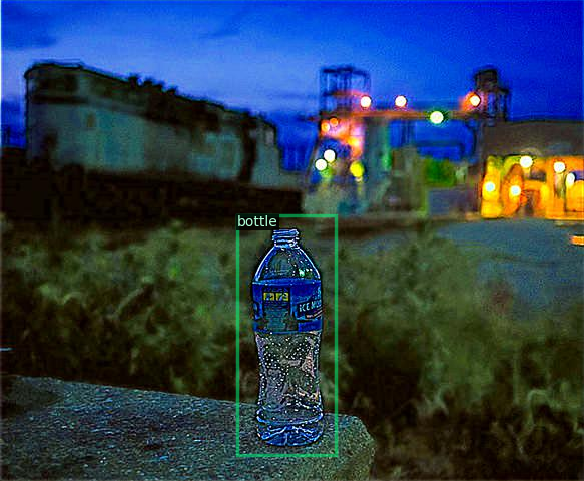

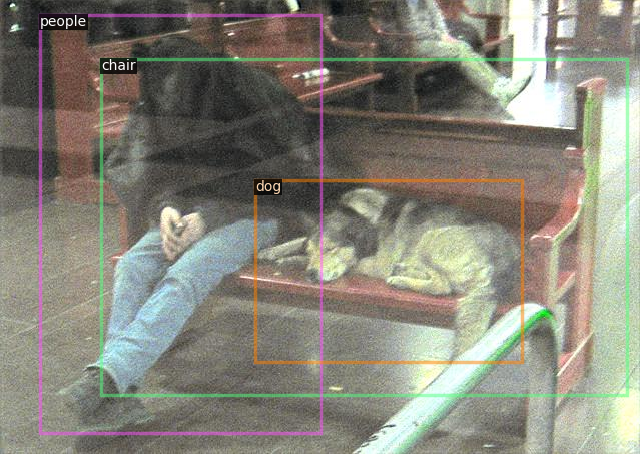

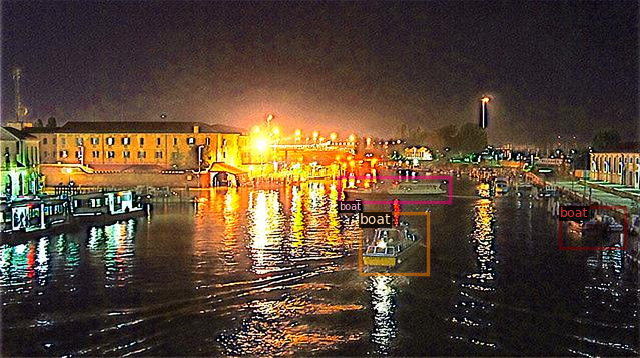

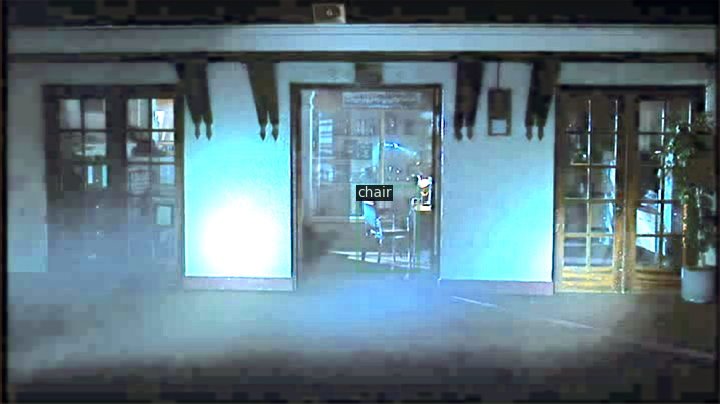

In [78]:
# Vis
dataset_dictionary = convert_data_to_dict("exdark_bright_mirnet/")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

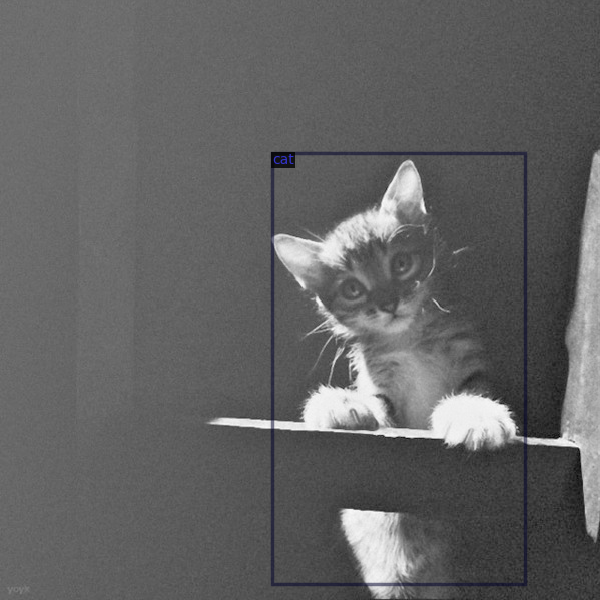

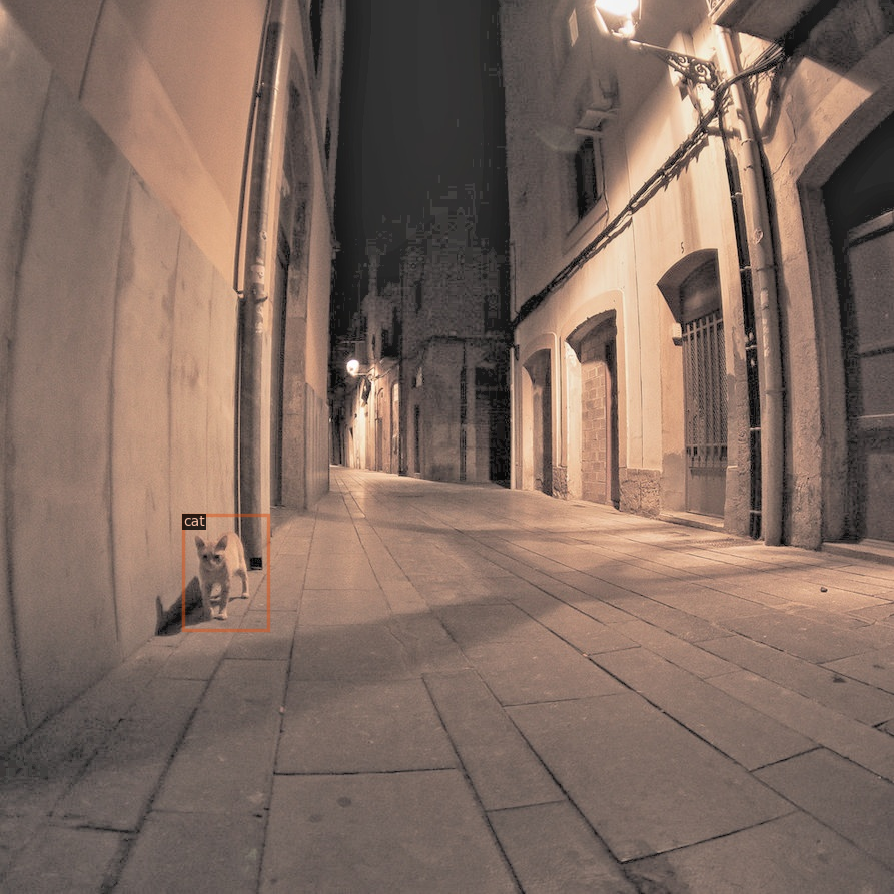

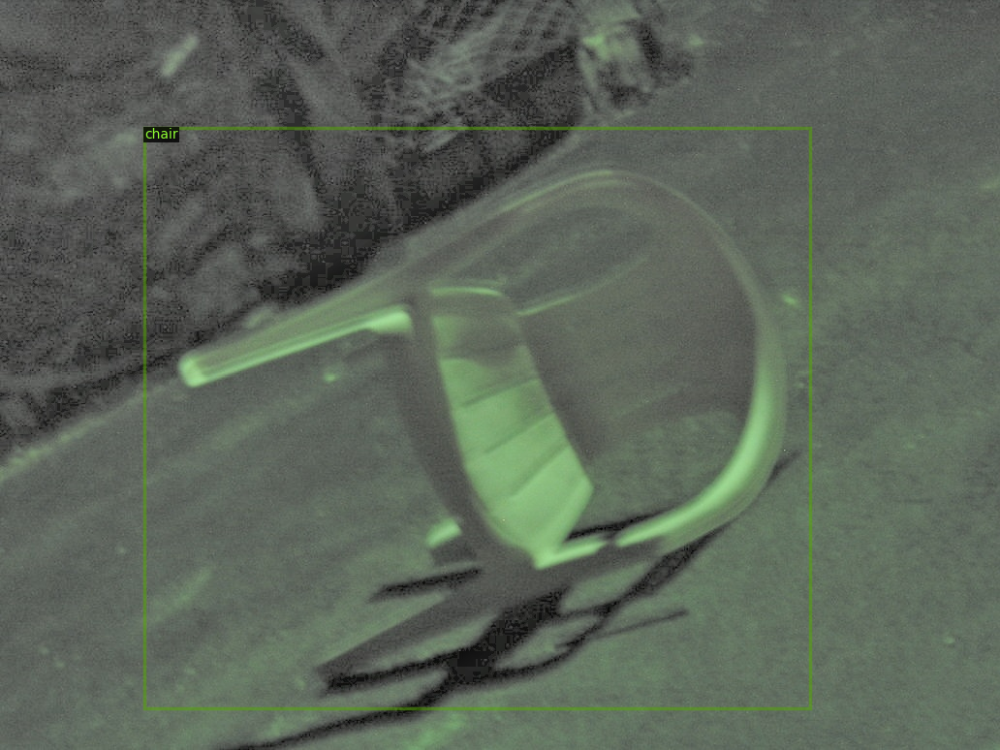

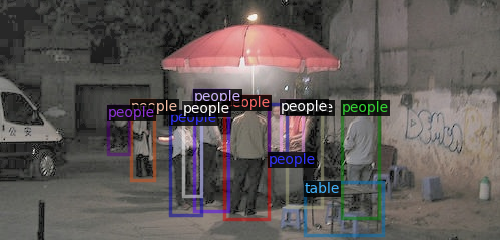

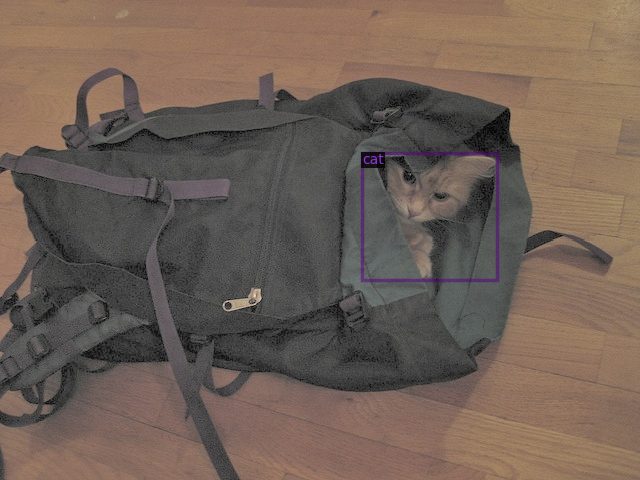

In [79]:
dataset_dictionary = convert_data_to_dict("exdark_bright/")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

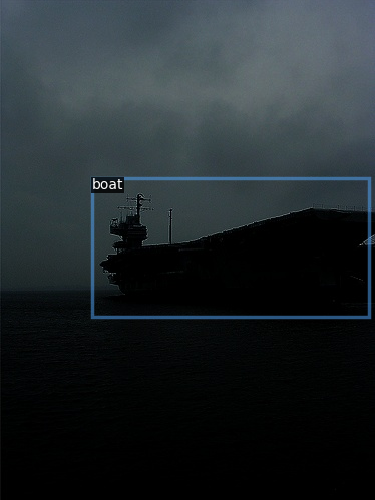

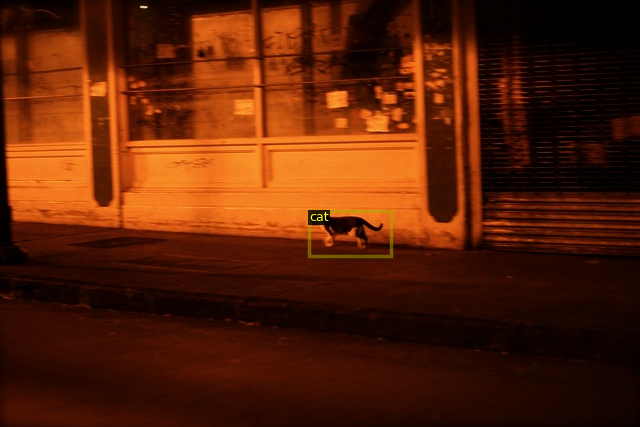

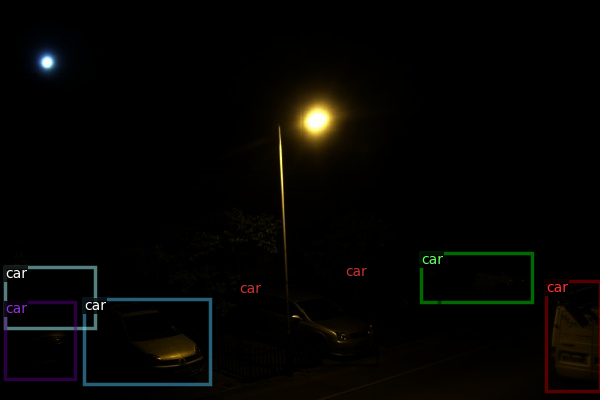

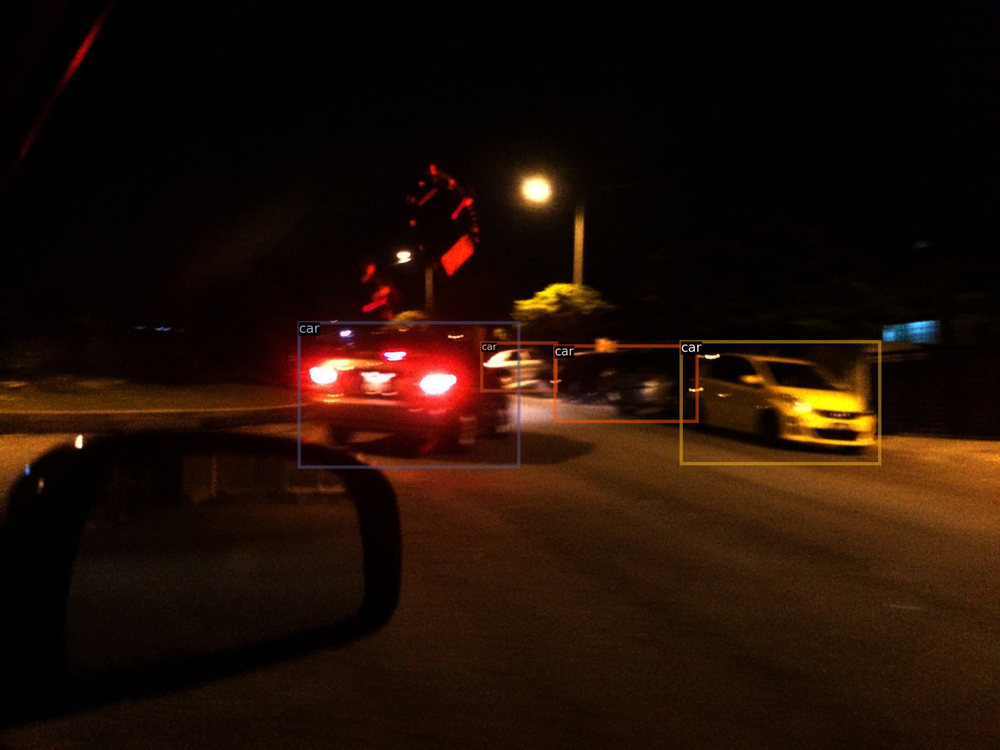

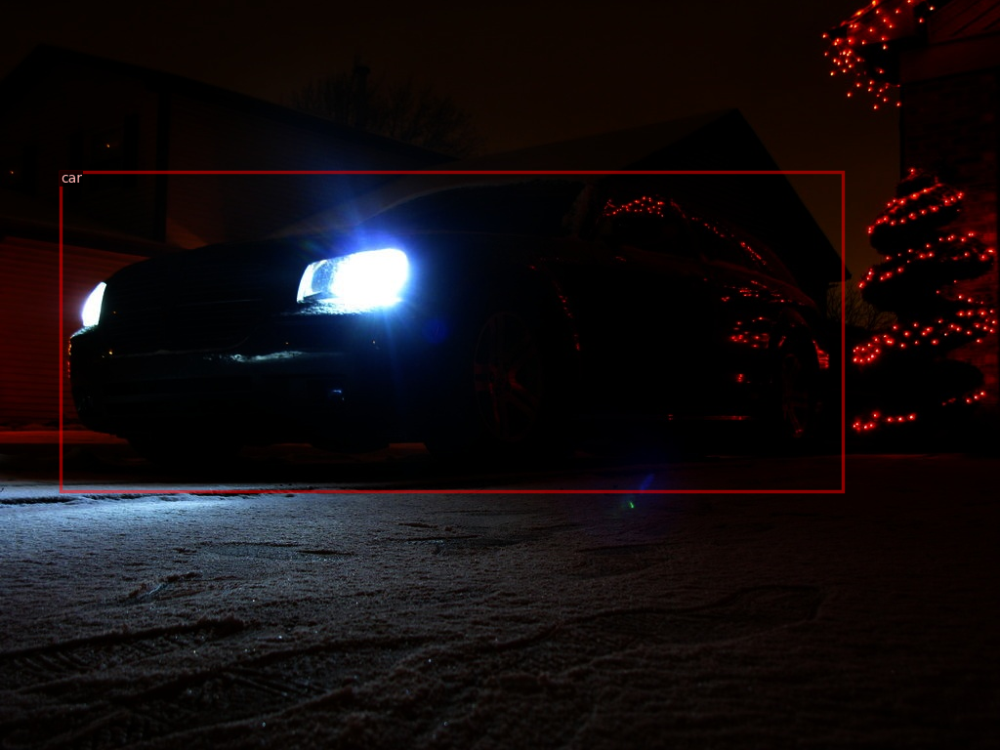

In [80]:
dataset_dictionary = convert_data_to_dict("exdark_dark/")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

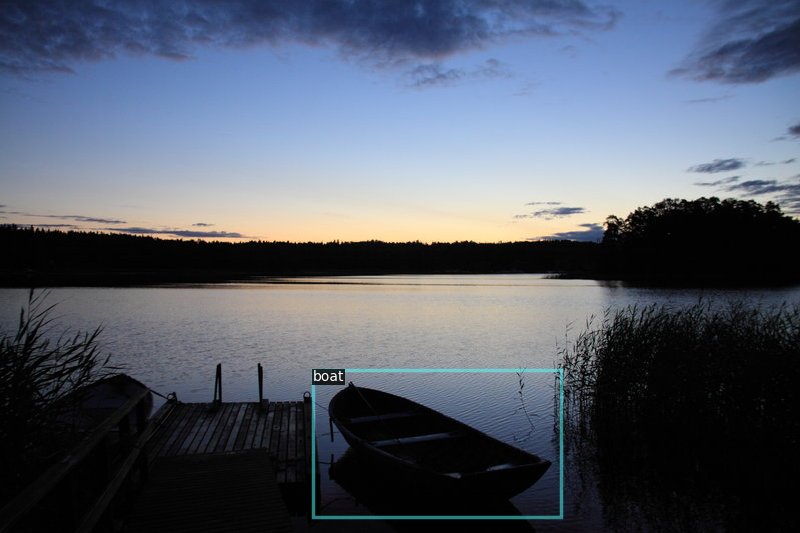

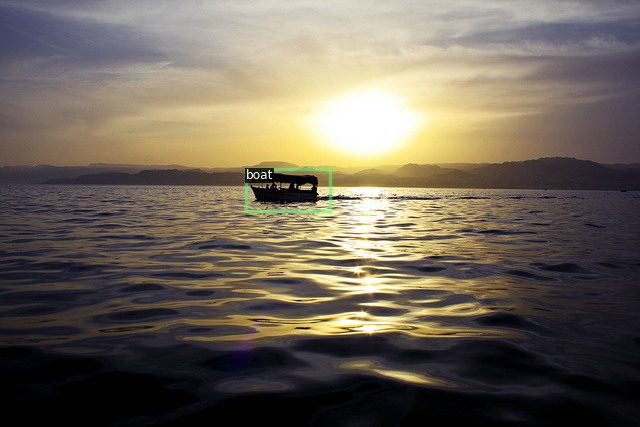

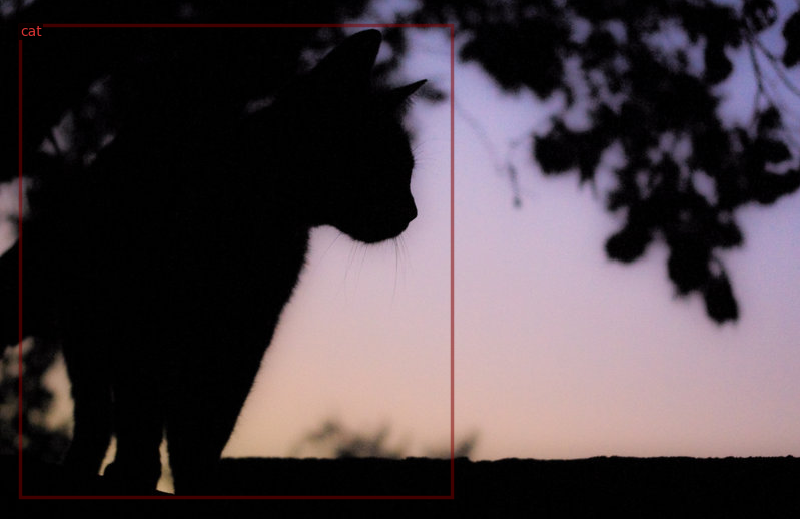

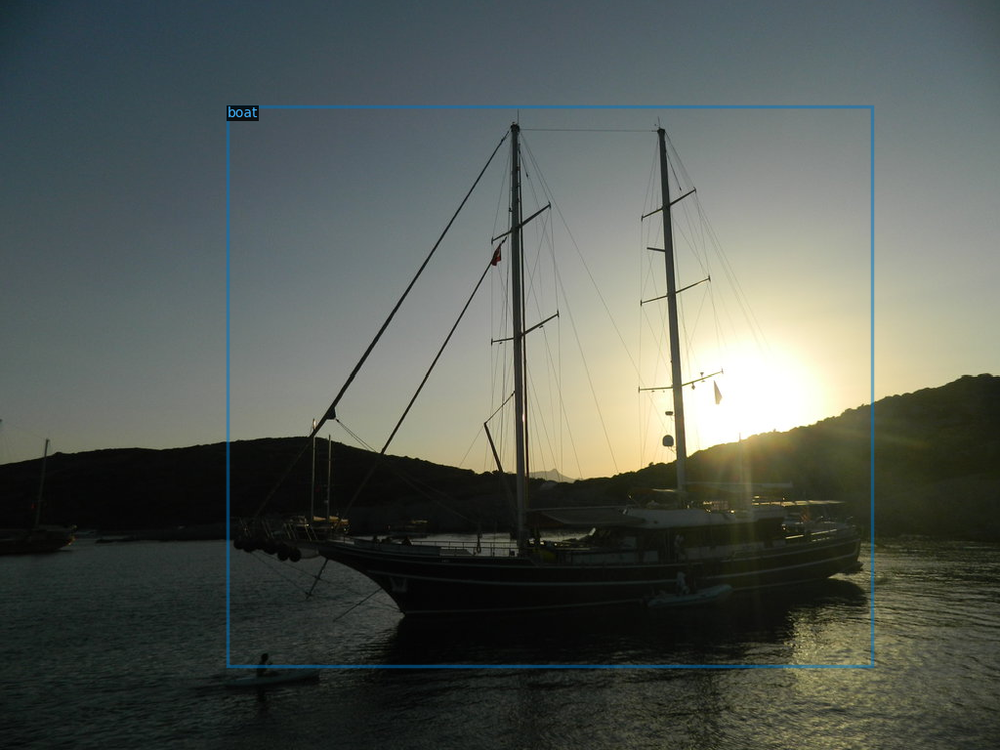

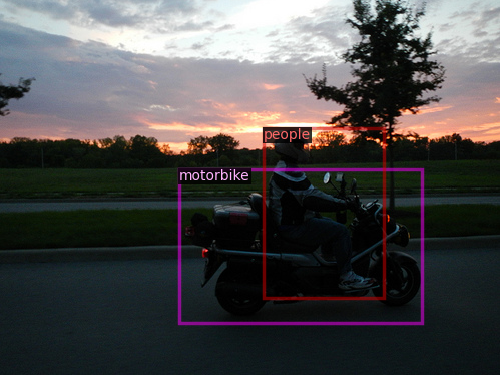

In [81]:
dataset_dictionary = convert_data_to_dict("exdark_split_light/Twilight")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

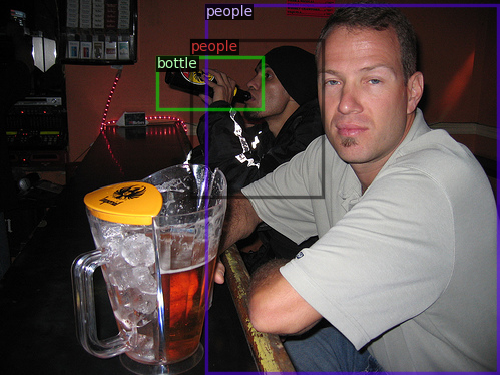

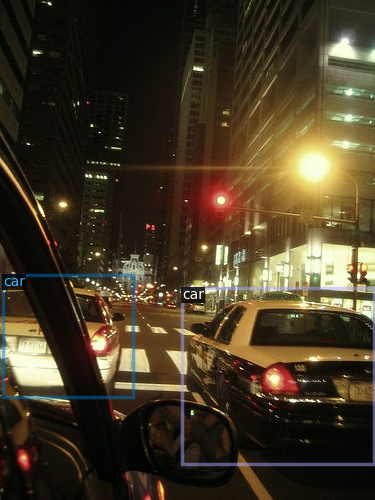

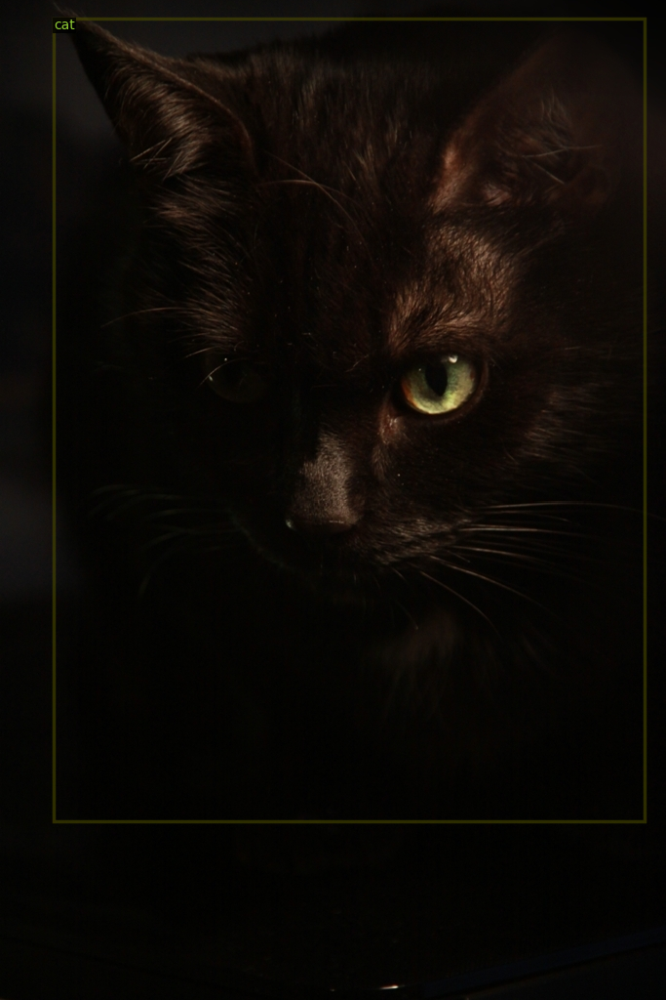

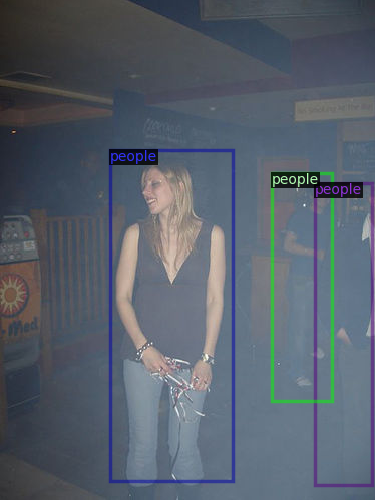

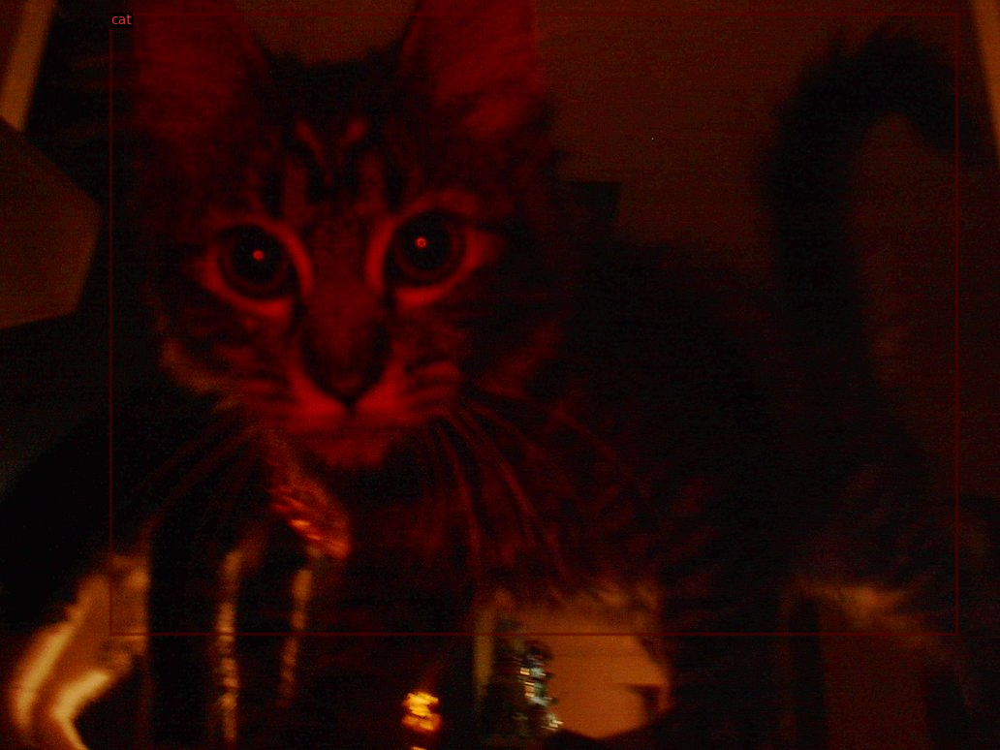

In [82]:
dataset_dictionary = convert_data_to_dict("exdark/train")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

In [83]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import DatasetMapper, MetadataCatalog, build_detection_train_loader
import detectron2.data.transforms as T
from detectron2.data import DatasetMapper

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)



In [84]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("boardetect_train",)
cfg.DATASETS.TEST = ("boardetect_test",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.0125  # pick a good LR
cfg.SOLVER.MAX_ITER = 1500   
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 # No. of classes = [HINDI, ENGLISH, OTHER]
cfg.TEST.EVAL_PERIOD = 500
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/01 00:20:46 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/01 00:21:58 d2.engine.train_loop]: Starting training from iteration 0
[05/01 00:22:18 d2.utils.events]:  eta: 0:24:08  iter: 19  total_loss: 2.907  loss_cls: 2.292  loss_box_reg: 0.5526  loss_rpn_cls: 0.01866  loss_rpn_loc: 0.01667    time: 0.9633  last_time: 0.8360  data_time: 0.0605  last_data_time: 0.0305   lr: 0.00024976  max_mem: 5345M
[05/01 00:22:38 d2.utils.events]:  eta: 0:24:04  iter: 39  total_loss: 1.379  loss_cls: 0.7352  loss_box_reg: 0.6045  loss_rpn_cls: 0.01804  loss_rpn_loc: 0.01846    time: 0.9809  last_time: 0.9442  data_time: 0.0396  last_data_time: 0.0432   lr: 0.00049951  max_mem: 5345M
[05/01 00:22:58 d2.utils.events]:  eta: 0:23:45  iter: 59  total_loss: 1.255  loss_cls: 0.6106  loss_box_reg: 0.562  loss_rpn_cls: 0.01442  loss_rpn_loc: 0.01706    time: 0.9793  last_time: 0.8914  data_time: 0.0432  last_data_time: 0.0493   lr: 0.00074926  max_mem: 5346M
[05/01 00:23:17 d2.utils.events]:  eta: 0:23:22  iter: 79  total_loss: 1.016  loss_cls: 0.48  loss_box_reg

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 00:30:45 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/01 00:30:46 d2.data.datasets.coco]: Conversion finished, #images: 1473, #annotations: 4594
[05/01 00:30:46 d2.data.datasets.coco]: Caching COCO format annotations at 'coco_eval/boardetect_test_coco_format.json' ...
[05/01 00:30:46 d2.evaluation.evaluator]: Start inference on 1473 batches
[05/01 00:30:48 d2.evaluation.evaluator]: Inference done 11/1473. Dataloading: 0.0035 s/iter. Inference: 0.1235 s/iter. Eval: 0.0004 s/iter. Total: 0.1274 s/iter. ETA=0:03:06
[05/01 00:30:53 d2.evaluation.evaluator]: Inference done 45/1473. Dataloading: 0.0117 s/iter. Inference: 0.1334 s/iter. Eval: 0.0004 s/iter. Total: 0.1457 s/iter. ETA=0:03:28
[05/01 00:30:58 d2.evaluation.evaluator]: Inference done 90/1473. Dataloading: 0.0077 s/iter. Inference: 0.1195 s/iter. Eval: 0.0004 s/iter. Total: 0.1278 s/iter. ETA=0:02:56
[05/01 00:31:03 d2.evaluation.evaluator]: Inference done 131/1473. Dataloading: 0.0066 s/iter. Infer

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 00:42:22 d2.evaluation.evaluator]: Inference done 11/1473. Dataloading: 0.0032 s/iter. Inference: 0.1144 s/iter. Eval: 0.0006 s/iter. Total: 0.1183 s/iter. ETA=0:02:52
[05/01 00:42:27 d2.evaluation.evaluator]: Inference done 47/1473. Dataloading: 0.0204 s/iter. Inference: 0.1170 s/iter. Eval: 0.0010 s/iter. Total: 0.1386 s/iter. ETA=0:03:17
[05/01 00:42:32 d2.evaluation.evaluator]: Inference done 93/1473. Dataloading: 0.0118 s/iter. Inference: 0.1107 s/iter. Eval: 0.0007 s/iter. Total: 0.1234 s/iter. ETA=0:02:50
[05/01 00:42:37 d2.evaluation.evaluator]: Inference done 137/1473. Dataloading: 0.0098 s/iter. Inference: 0.1102 s/iter. Eval: 0.0006 s/iter. Total: 0.1208 s/iter. ETA=0:02:41
[05/01 00:42:42 d2.evaluation.evaluator]: Inference done 180/1473. Dataloading: 0.0091 s/iter. Inference: 0.1101 s/iter. Eval: 0.0006 s/iter. Total: 0.1199 s/iter. ETA=0:02:35
[05/01 00:42:47 d2.evaluation.evaluator]: Inference done 222/1473. Dataloading: 0.0088 s/iter. Inference: 0.1102 s/iter. Ev

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 00:53:58 d2.evaluation.evaluator]: Inference done 11/1473. Dataloading: 0.0013 s/iter. Inference: 0.1128 s/iter. Eval: 0.0004 s/iter. Total: 0.1146 s/iter. ETA=0:02:47
[05/01 00:54:03 d2.evaluation.evaluator]: Inference done 46/1473. Dataloading: 0.0197 s/iter. Inference: 0.1211 s/iter. Eval: 0.0006 s/iter. Total: 0.1416 s/iter. ETA=0:03:22
[05/01 00:54:09 d2.evaluation.evaluator]: Inference done 90/1473. Dataloading: 0.0145 s/iter. Inference: 0.1131 s/iter. Eval: 0.0005 s/iter. Total: 0.1282 s/iter. ETA=0:02:57
[05/01 00:54:14 d2.evaluation.evaluator]: Inference done 134/1473. Dataloading: 0.0121 s/iter. Inference: 0.1118 s/iter. Eval: 0.0005 s/iter. Total: 0.1245 s/iter. ETA=0:02:46
[05/01 00:54:19 d2.evaluation.evaluator]: Inference done 176/1473. Dataloading: 0.0111 s/iter. Inference: 0.1116 s/iter. Eval: 0.0005 s/iter. Total: 0.1232 s/iter. ETA=0:02:39
[05/01 00:54:24 d2.evaluation.evaluator]: Inference done 218/1473. Dataloading: 0.0105 s/iter. Inference: 0.1114 s/iter. Ev

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [85]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8  # set the testing threshold for this model
cfg.DATASETS.TEST = ("boardetect_test", )
predictor = DefaultPredictor(cfg)

[05/01 00:57:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


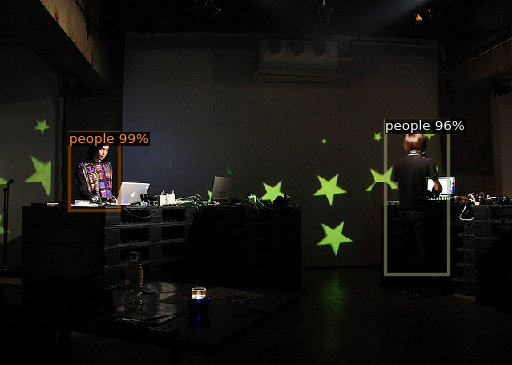

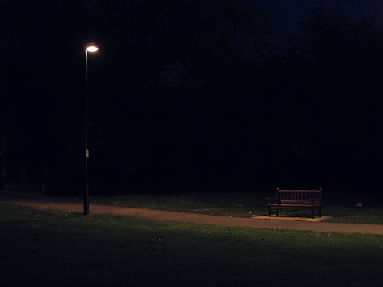

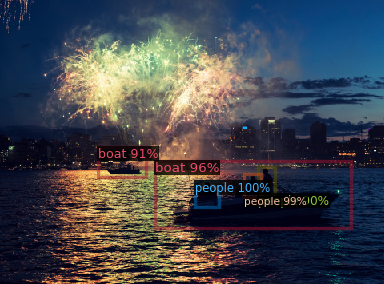

In [86]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_board_dicts("exdark/test")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=board_metadata, 
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [87]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("boardetect_test", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "boardetect_test")
inference_on_dataset(predictor.model, val_loader, evaluator)

[05/01 00:58:15 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/01 00:58:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 00:58:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/01 00:58:35 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/01 00:58:35 d2.data.common]: Serializing 1473 elements to byte tensors and concatenating them all ...
[05/01 00:58:35 d2.data.common]: Serialized dataset takes 0.38 MiB
[05/01 00:58:35 d2.evaluation.evaluator]: Start inference on 1473 batches


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 00:58:37 d2.evaluation.evaluator]: Inference done 11/1473. Dataloading: 0.0012 s/iter. Inference: 0.1135 s/iter. Eval: 0.0002 s/iter. Total: 0.1150 s/iter. ETA=0:02:48
[05/01 00:58:42 d2.evaluation.evaluator]: Inference done 55/1473. Dataloading: 0.0058 s/iter. Inference: 0.1090 s/iter. Eval: 0.0003 s/iter. Total: 0.1152 s/iter. ETA=0:02:43
[05/01 00:58:47 d2.evaluation.evaluator]: Inference done 99/1473. Dataloading: 0.0059 s/iter. Inference: 0.1090 s/iter. Eval: 0.0003 s/iter. Total: 0.1154 s/iter. ETA=0:02:38
[05/01 00:58:52 d2.evaluation.evaluator]: Inference done 140/1473. Dataloading: 0.0070 s/iter. Inference: 0.1102 s/iter. Eval: 0.0003 s/iter. Total: 0.1176 s/iter. ETA=0:02:36
[05/01 00:58:57 d2.evaluation.evaluator]: Inference done 185/1473. Dataloading: 0.0061 s/iter. Inference: 0.1097 s/iter. Eval: 0.0003 s/iter. Total: 0.1162 s/iter. ETA=0:02:29
[05/01 00:59:02 d2.evaluation.evaluator]: Inference done 224/1473. Dataloading: 0.0075 s/iter. Inference: 0.1107 s/iter. Ev

OrderedDict([('bbox',
              {'AP': 17.686186709487743,
               'AP50': 34.50104386391062,
               'AP75': 16.249208165973027,
               'APs': 4.700275630479564,
               'APm': 14.012186848554606,
               'APl': 19.804280189266336,
               'AP-bicycle': 26.603464972904046,
               'AP-boat': 13.820231918328501,
               'AP-bottle': 21.226429533862483,
               'AP-bus': 39.51709787714362,
               'AP-car': 30.334439610981374,
               'AP-cat': 1.8333756452568333,
               'AP-chair': 12.798289123392054,
               'AP-cup': 14.591166768468886,
               'AP-dog': 13.864541507794037,
               'AP-motorbike': 10.718831590777695,
               'AP-people': 21.10929067592009,
               'AP-table': 5.817081289023315})])

In [88]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("boardetect_bright", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "boardetect_bright")
inference_on_dataset(predictor.model, val_loader, evaluator)

[05/01 01:01:48 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/01 01:01:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 01:01:48 d2.evaluation.coco_evaluation]: Trying to convert 'boardetect_bright' to COCO format ...
[05/01 01:01:48 d2.data.datasets.coco]: Converting annotations of dataset 'boardetect_bright' to COCO format ...)
[05/01 01:01:50 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/01 01:01:51 d2.data.datasets.coco]: Conversion finished, #images: 199, #annotations: 625
[05/01 01:01:51 d2.data.datasets.coco]: Caching COCO format annotations at '/output/boardetect_bright_coco_format.json' ...
[05/01 01:01:53 d2.data.build]: Distribution of instances among all 12 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 01:01:55 d2.evaluation.evaluator]: Inference done 11/199. Dataloading: 0.0252 s/iter. Inference: 0.1317 s/iter. Eval: 0.0003 s/iter. Total: 0.1572 s/iter. ETA=0:00:29
[05/01 01:02:00 d2.evaluation.evaluator]: Inference done 54/199. Dataloading: 0.0082 s/iter. Inference: 0.1132 s/iter. Eval: 0.0003 s/iter. Total: 0.1220 s/iter. ETA=0:00:17
[05/01 01:02:05 d2.evaluation.evaluator]: Inference done 98/199. Dataloading: 0.0079 s/iter. Inference: 0.1108 s/iter. Eval: 0.0002 s/iter. Total: 0.1191 s/iter. ETA=0:00:12
[05/01 01:02:10 d2.evaluation.evaluator]: Inference done 141/199. Dataloading: 0.0069 s/iter. Inference: 0.1115 s/iter. Eval: 0.0002 s/iter. Total: 0.1187 s/iter. ETA=0:00:06
[05/01 01:02:15 d2.evaluation.evaluator]: Inference done 177/199. Dataloading: 0.0091 s/iter. Inference: 0.1140 s/iter. Eval: 0.0003 s/iter. Total: 0.1235 s/iter. ETA=0:00:02
[05/01 01:02:19 d2.evaluation.evaluator]: Total inference time: 0:00:24.338156 (0.125454 s / iter per device, on 1 devices)
[05/

OrderedDict([('bbox',
              {'AP': 15.493490554905831,
               'AP50': 28.5033991322526,
               'AP75': 15.196572468220584,
               'APs': 13.324466970506577,
               'APm': 14.313683804073978,
               'APl': 15.930777788974778,
               'AP-bicycle': 21.987698069323475,
               'AP-boat': 13.815468793842944,
               'AP-bottle': 16.76072607260726,
               'AP-bus': 42.104746188904606,
               'AP-car': 24.86573161525817,
               'AP-cat': 0.5940594059405939,
               'AP-chair': 9.661327410936583,
               'AP-cup': 14.108910891089108,
               'AP-dog': 6.138613861386139,
               'AP-motorbike': 10.376237623762377,
               'AP-people': 17.726659983715937,
               'AP-table': 7.781706742102783})])

In [89]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("boardetect_Ambient", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "boardetect_Ambient")
inference_on_dataset(predictor.model, val_loader, evaluator)

[05/01 01:03:04 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/01 01:03:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 01:03:04 d2.evaluation.coco_evaluation]: Trying to convert 'boardetect_Ambient' to COCO format ...
[05/01 01:03:04 d2.data.datasets.coco]: Converting annotations of dataset 'boardetect_Ambient' to COCO format ...)
[05/01 01:03:37 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/01 01:03:38 d2.data.datasets.coco]: Conversion finished, #images: 2098, #annotations: 4709
[05/01 01:03:38 d2.data.datasets.coco]: Caching COCO format annotations at '/output/boardetect_Ambient_coco_format.json' ...
[05/01 01:04:05 d2.data.build]: Distribution of instances among all 12 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:----------

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 01:04:07 d2.evaluation.evaluator]: Inference done 11/2098. Dataloading: 0.0050 s/iter. Inference: 0.1071 s/iter. Eval: 0.0002 s/iter. Total: 0.1123 s/iter. ETA=0:03:54
[05/01 01:04:12 d2.evaluation.evaluator]: Inference done 56/2098. Dataloading: 0.0050 s/iter. Inference: 0.1071 s/iter. Eval: 0.0002 s/iter. Total: 0.1125 s/iter. ETA=0:03:49
[05/01 01:04:17 d2.evaluation.evaluator]: Inference done 96/2098. Dataloading: 0.0062 s/iter. Inference: 0.1116 s/iter. Eval: 0.0002 s/iter. Total: 0.1181 s/iter. ETA=0:03:56
[05/01 01:04:23 d2.evaluation.evaluator]: Inference done 131/2098. Dataloading: 0.0066 s/iter. Inference: 0.1191 s/iter. Eval: 0.0002 s/iter. Total: 0.1262 s/iter. ETA=0:04:08
[05/01 01:04:28 d2.evaluation.evaluator]: Inference done 168/2098. Dataloading: 0.0108 s/iter. Inference: 0.1171 s/iter. Eval: 0.0002 s/iter. Total: 0.1283 s/iter. ETA=0:04:07
[05/01 01:04:33 d2.evaluation.evaluator]: Inference done 211/2098. Dataloading: 0.0100 s/iter. Inference: 0.1156 s/iter. Ev

OrderedDict([('bbox',
              {'AP': 18.088216533684577,
               'AP50': 33.895473651173255,
               'AP75': 18.339637740280946,
               'APs': 7.659856461836659,
               'APm': 13.10045488527182,
               'APl': 18.818812682302582,
               'AP-bicycle': 29.590106221056335,
               'AP-boat': 17.345852585758823,
               'AP-bottle': 29.679900805568405,
               'AP-bus': 33.78464531548245,
               'AP-car': 26.667189249675943,
               'AP-cat': 2.1692123489412087,
               'AP-chair': 11.613134091089327,
               'AP-cup': 18.33213835978104,
               'AP-dog': 12.073676956331377,
               'AP-motorbike': 10.673860370776122,
               'AP-people': 19.666254919964757,
               'AP-table': 5.462627179789084})])

In [90]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("boardetect_bright_mirnet", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "boardetect_bright_mirnet")
inference_on_dataset(predictor.model, val_loader, evaluator)

[05/01 01:09:07 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/01 01:09:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 01:09:07 d2.evaluation.coco_evaluation]: Trying to convert 'boardetect_bright_mirnet' to COCO format ...
[05/01 01:09:07 d2.data.datasets.coco]: Converting annotations of dataset 'boardetect_bright_mirnet' to COCO format ...)
[05/01 01:09:11 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/01 01:09:11 d2.data.datasets.coco]: Conversion finished, #images: 269, #annotations: 889
[05/01 01:09:11 d2.data.datasets.coco]: Caching COCO format annotations at '/output/boardetect_bright_mirnet_coco_format.json' ...
[05/01 01:09:13 d2.data.build]: Distribution of instances among all 12 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:-------

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/01 01:09:15 d2.evaluation.evaluator]: Inference done 11/269. Dataloading: 0.0012 s/iter. Inference: 0.1083 s/iter. Eval: 0.0003 s/iter. Total: 0.1098 s/iter. ETA=0:00:28
[05/01 01:09:20 d2.evaluation.evaluator]: Inference done 55/269. Dataloading: 0.0058 s/iter. Inference: 0.1077 s/iter. Eval: 0.0002 s/iter. Total: 0.1138 s/iter. ETA=0:00:24
[05/01 01:09:25 d2.evaluation.evaluator]: Inference done 93/269. Dataloading: 0.0107 s/iter. Inference: 0.1116 s/iter. Eval: 0.0002 s/iter. Total: 0.1227 s/iter. ETA=0:00:21
[05/01 01:09:30 d2.evaluation.evaluator]: Inference done 137/269. Dataloading: 0.0084 s/iter. Inference: 0.1111 s/iter. Eval: 0.0002 s/iter. Total: 0.1199 s/iter. ETA=0:00:15
[05/01 01:09:35 d2.evaluation.evaluator]: Inference done 182/269. Dataloading: 0.0072 s/iter. Inference: 0.1107 s/iter. Eval: 0.0002 s/iter. Total: 0.1182 s/iter. ETA=0:00:10
[05/01 01:09:40 d2.evaluation.evaluator]: Inference done 222/269. Dataloading: 0.0079 s/iter. Inference: 0.1116 s/iter. Eval: 0.

OrderedDict([('bbox',
              {'AP': 14.401441023260118,
               'AP50': 26.4256371778164,
               'AP75': 13.933806558051973,
               'APs': 5.335483548354834,
               'APm': 13.03002880424823,
               'APl': 16.097600444292556,
               'AP-bicycle': 26.311121387802693,
               'AP-boat': 11.626743993080629,
               'AP-bottle': 21.459477621970343,
               'AP-bus': 37.88897351273589,
               'AP-car': 19.651012940590658,
               'AP-cat': 0.4455445544554455,
               'AP-chair': 8.150229728855239,
               'AP-cup': 10.567656765676567,
               'AP-dog': 9.504950495049505,
               'AP-motorbike': 8.432343234323433,
               'AP-people': 14.389799100686588,
               'AP-table': 4.3894389438943895})])